In [ ]:
hay mas ecenasssssssss

In [22]:








#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Extract patches and corresponding masks from a multi‐scene OME-TIFF image,
preserving true RGB channels and ensuring correct spatial alignment
between image patches and mask geometries.

Annotated background ('ignore-fondo') is mapped to 0,
tumor to 1, stroma to 2,
and any unannotated region (holes) is classified based on brightness per pixel:
  - mean RGB > 190  → ignore-fondo (0)
  - otherwise       → stroma (2)
Polygon holes are repainted and then classified accordingly,
pero SOLO si la máscara contiene alguna anotación (valor != 255).
"""
import os
import json
import logging
from pathlib import Path
import numpy as np
import cv2
from shapely.geometry import shape
from shapely.affinity import translate
import tifffile
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor, as_completed

########################################
# CONFIGURACIÓN Y PARÁMETROS
########################################
BASE_IMG_PATH     = Path(r"\\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\imagenes")
OME_FILENAME      = "HC22B0006126_HE.tif"
BASE_ANN_PATH     = (
    r"\\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab"
    r"\patrones_invasion\OME_PATRONES_QPATH\anotaciones"
    r"\HC22B0006126_HE"
)
PATCH_SIZE        = 2048
STRIDE            = PATCH_SIZE  # ajustar para solape si se desea

LOCAL_OUTPUT_ROOT = Path(r"C:\temp\patches_2048")
NET_OUTPUT_ROOT   = BASE_IMG_PATH / "patches_2048"

MAX_CPU_WORKERS   = 8
MAX_IO_WORKERS    = 2
PNG_COMPRESSION   = 1

# Tres clases: ignore-fondo (0), tumor (1), Stroma (2)
CLASS_MAP = {
    'ignore-fondo': 0,
    'tumor':        1,
    'Stroma':       2
}

# Umbral de brillo para clasificar huecos (por píxel)
HOLE_THRESHOLD = 190

logging.basicConfig(level=logging.INFO, format="[%(levelname)s] %(message)s")
logger = logging.getLogger(__name__)

class RobustPatchExtractor:
    def __init__(self,
                 img_path: Path,
                 ann_path: str,
                 patch_size: int = PATCH_SIZE,
                 stride: int = STRIDE,
                 tissue_thresh: float = 0.05,
                 local_root: Path = LOCAL_OUTPUT_ROOT,
                 net_root: Path = NET_OUTPUT_ROOT):
        self.ome_file       = img_path / OME_FILENAME
        self.ann_dir        = Path(ann_path)
        self.patch_size     = patch_size
        self.stride         = stride
        self.tissue_thresh  = tissue_thresh
        self.local_root     = local_root / self.ome_file.stem
        self.net_root       = net_root   / self.ome_file.stem
        self.annotations    = []
        self.img            = None
        self.H = self.W     = 0
        self.class_map      = CLASS_MAP

    def load_scene(self):
        logger.info(f"Cargando OME-TIFF {self.ome_file}")
        arr = tifffile.imread(str(self.ome_file))
        arr = np.squeeze(arr)
        if arr.ndim == 2:
            arr = np.stack([arr]*3, axis=-1)
        elif arr.ndim == 3:
            h, w, c = arr.shape
            if c not in (1,2,3,4):
                arr = arr.transpose(1,2,0)
            if arr.shape[2] > 3:
                logger.warning(f"Tengo {arr.shape[2]} canales, usando solo los 3 primeros")
                arr = arr[:, :, :3]
            elif arr.shape[2] == 1:
                arr = np.repeat(arr, 3, axis=2)
        else:
            for _ in range(arr.ndim-3):
                arr = arr.max(axis=0)
            arr = np.squeeze(arr)
            if arr.ndim == 2:
                arr = np.stack([arr]*3, axis=-1)
        self.img = arr.astype(np.uint8)
        self.H, self.W = self.img.shape[:2]
        logger.info(f"Imagen cargada con shape {self.img.shape}")

    def load_annotations(self, class_map: dict):
        logger.info(f"Cargando anotaciones de {self.ann_dir}")
        self.class_map = class_map
        for fn in self.ann_dir.rglob('*.geojson'):
            data = json.loads(fn.read_text(encoding='utf-8'))
            for feat in data.get('features', []):
                name = feat['properties']['classification']['name']
                if name not in class_map:
                    continue
                idx = class_map[name]
                geom = shape(feat['geometry'])
                if geom.geom_type == 'Polygon':
                    self.annotations.append((idx, geom))
                else:
                    for poly in geom.geoms:
                        self.annotations.append((idx, poly))
        logger.info(f"{len(self.annotations)} polígonos cargados")

    def is_tissue(self, patch: np.ndarray) -> bool:
        gray = cv2.cvtColor(patch, cv2.COLOR_RGB2GRAY)
        _, thr = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        return (thr == 0).mean() > self.tissue_thresh

    def rasterize_mask(self, x0: int, y0: int) -> np.ndarray:
        mask = np.full((self.patch_size, self.patch_size), 255, dtype=np.uint8)
        for cls_idx, poly in self.annotations:
            minx, miny, maxx, maxy = poly.bounds
            if maxx < x0 or minx > x0 + self.patch_size or maxy < y0 or miny > y0 + self.patch_size:
                continue
            shp = translate(poly, xoff=-x0, yoff=-y0)
            ext = np.array(shp.exterior.coords).round().astype(np.int32)
            cv2.fillPoly(mask, [ext], int(cls_idx))
            for interior in shp.interiors:
                hole = np.array(interior.coords).round().astype(np.int32)
                cv2.fillPoly(mask, [hole], 255)
        return mask

    def pad_patch(self, patch: np.ndarray) -> np.ndarray:
        h, w = patch.shape[:2]
        dh = self.patch_size - h
        dw = self.patch_size - w
        if dh > 0 or dw > 0:
            patch = np.pad(
                patch,
                ((0, max(dh,0)), (0, max(dw,0)), (0,0)),
                mode='constant',
                constant_values=255
            )
        return patch

    def save_patch(self, patch_id: int, patch: np.ndarray, mask: np.ndarray):
        out_dir = self.local_root
        out_dir.mkdir(parents=True, exist_ok=True)
        cv2.imwrite(
            str(out_dir / f"patch_{patch_id:04d}.png"),
            cv2.cvtColor(patch, cv2.COLOR_RGB2BGR),
            [cv2.IMWRITE_PNG_COMPRESSION, PNG_COMPRESSION]
        )
        cv2.imwrite(
            str(out_dir / f"mask_{patch_id:04d}.png"),
            mask,
            [cv2.IMWRITE_PNG_COMPRESSION, PNG_COMPRESSION]
        )

    def process_task(self, task):
        i, j, x0, y0 = task
        patch = self.img[y0:y0+self.patch_size, x0:x0+self.patch_size]
        patch = self.pad_patch(patch)
        if not self.is_tissue(patch):
            return None

        mask = self.rasterize_mask(x0, y0)

        # Solo si hay al menos un píxel anotado (valor != 255)
        if np.any(mask != 255):
            hole_mask = (mask == 255)
            if hole_mask.any():
                brightness = patch.mean(axis=2)
                mask[np.logical_and(hole_mask, brightness >  HOLE_THRESHOLD)] = self.class_map['ignore-fondo']
                mask[np.logical_and(hole_mask, brightness <= HOLE_THRESHOLD)] = self.class_map['Stroma']

        return (i, j, patch, mask)

    def extract(self):
        self.load_scene()
        self.load_annotations(CLASS_MAP)
        n_x = int(np.ceil((self.W - self.patch_size) / self.stride)) + 1
        n_y = int(np.ceil((self.H - self.patch_size) / self.stride)) + 1
        tasks = [
            (i, j,
             min(j*self.stride, self.W - self.patch_size),
             min(i*self.stride, self.H - self.patch_size))
            for i in range(n_y) for j in range(n_x)
        ]
        results = []
        with ThreadPoolExecutor(max_workers=MAX_CPU_WORKERS) as pool:
            futures = {pool.submit(self.process_task, t): t for t in tasks}
            for fut in tqdm(as_completed(futures), total=len(tasks), desc="Procesando parches"):
                res = fut.result()
                if res:
                    results.append(res)
        with ThreadPoolExecutor(max_workers=MAX_IO_WORKERS) as io_pool:
            for i, j, patch, mask in results:
                pid = i * n_x + j
                io_pool.submit(self.save_patch, pid, patch, mask)

        os.makedirs(self.net_root, exist_ok=True)
        os.system(f'robocopy "{self.local_root}" "{self.net_root}" /E /Z /NFL /NDL')
        logger.info("Proceso completado con éxito.")

if __name__ == "__main__":
    extractor = RobustPatchExtractor(
        img_path=BASE_IMG_PATH,
        ann_path=BASE_ANN_PATH
    )
    extractor.extract()


[INFO] Cargando OME-TIFF \\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\imagenes\HC22B0006126_HE.tif
[INFO] Imagen cargada con shape (93380, 50195, 3)
[INFO] Cargando anotaciones de \\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\anotaciones\HC22B0006126_HE
[INFO] 23304 polígonos cargados
Procesando parches: 100%|██████████████████████████████████████████████████████████| 1150/1150 [11:53<00:00,  1.61it/s]
[INFO] Proceso completado con éxito.


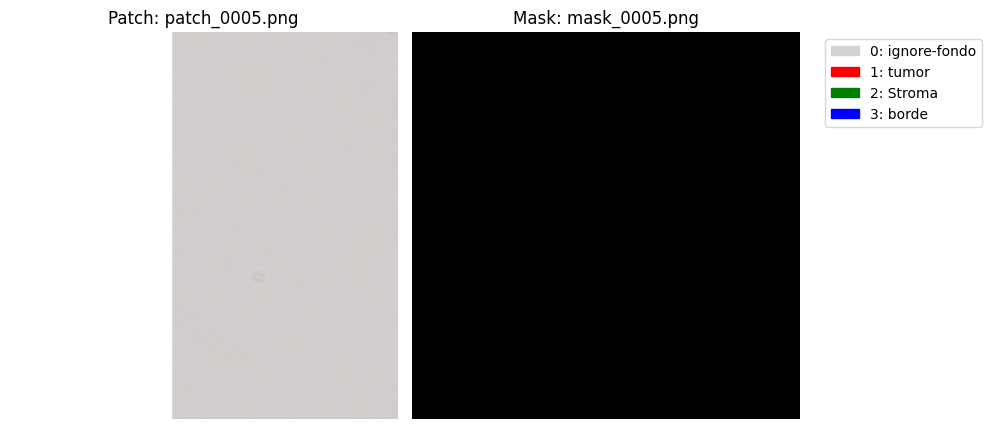

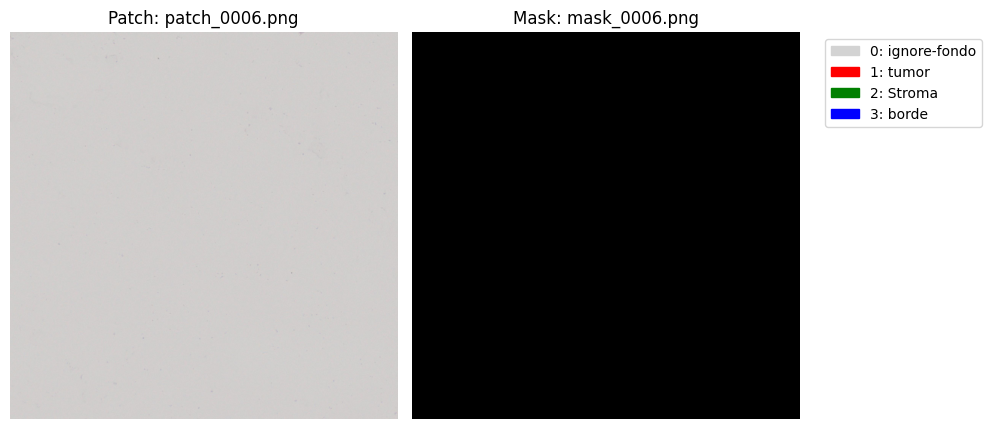

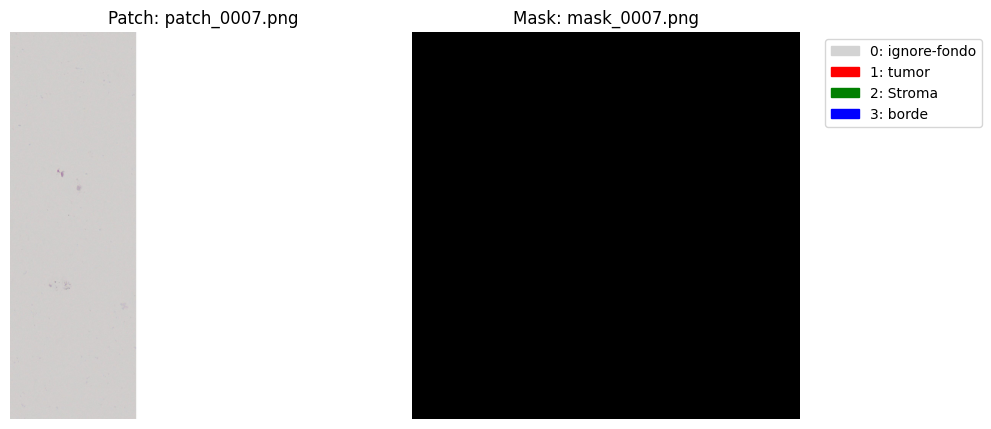

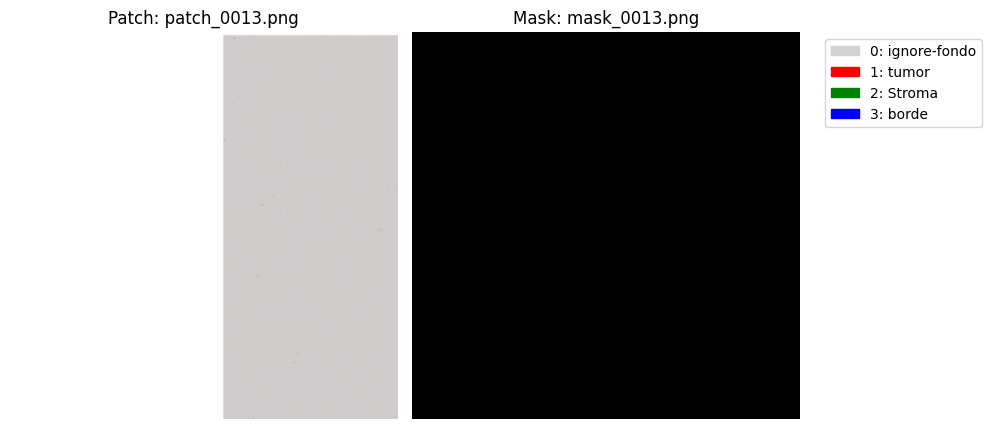

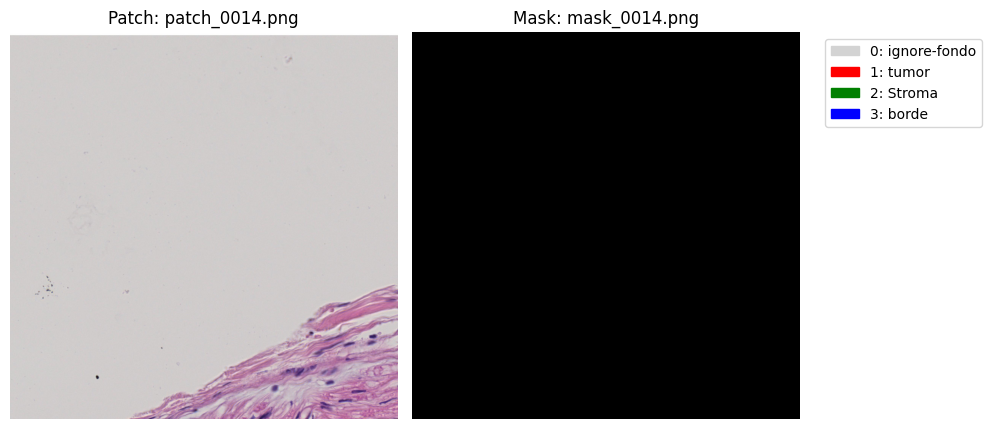

...

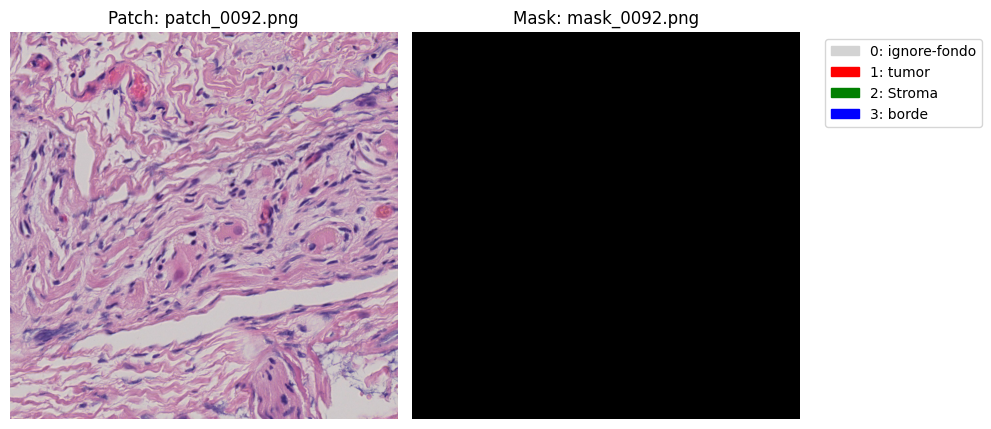

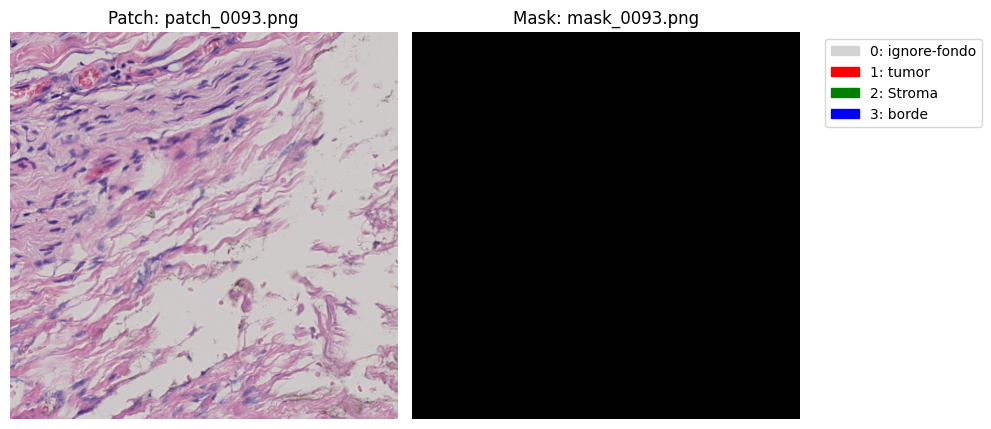

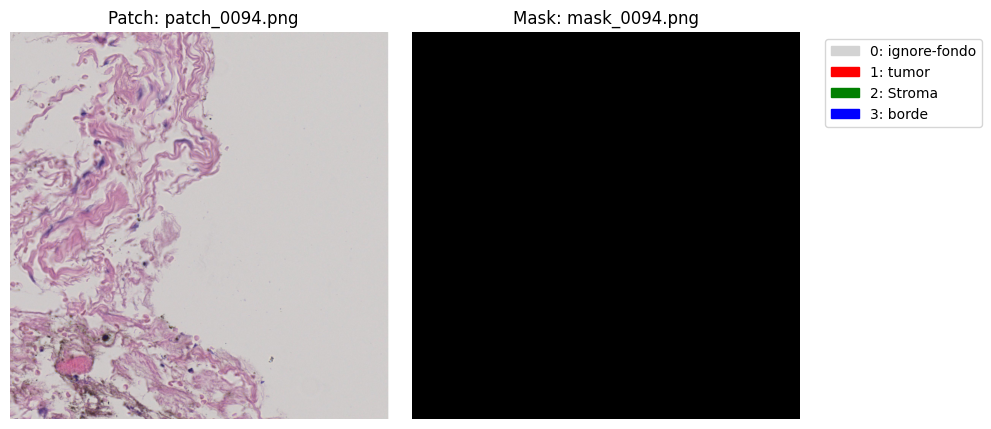

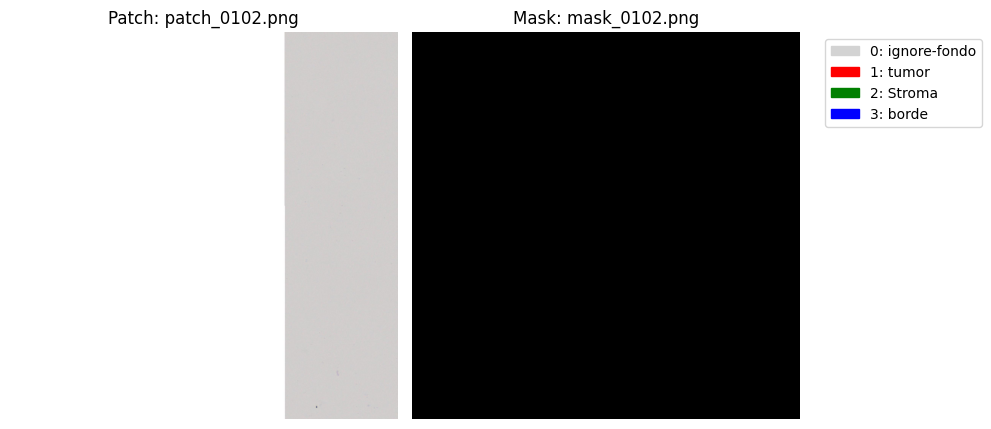

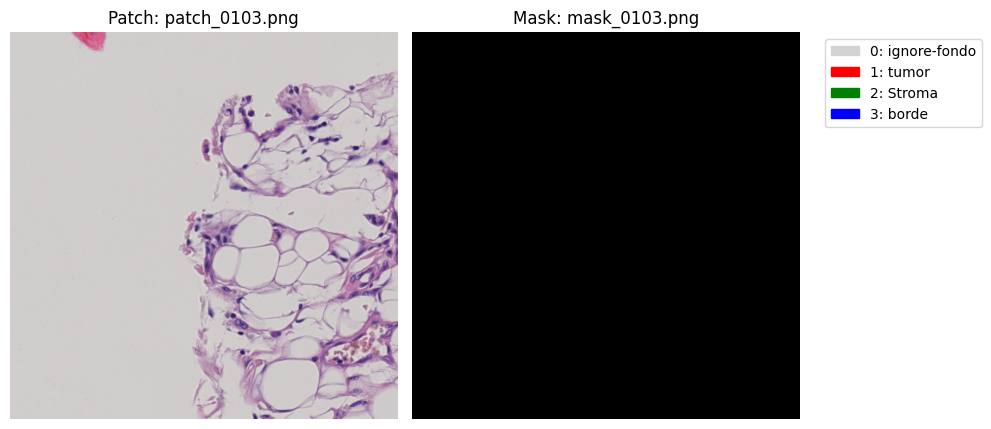


KeyboardInterrupt



In [26]:
import glob
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# 1) Carpeta de parches
patch_dir = r"\\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\imagenes\patches_2048\HC22B0006126_HE"

# 2) Mapa de clases y colores
class_map = {
    0: 'ignore-fondo',
    1: 'tumor',
    2: 'Stroma',
    3: 'borde'
}
color_map = {
    0: 'lightgray',
    1: 'red',
    2: 'green',  # Stroma
    3: 'blue'
}

# 3) Listar pares de patch y máscara
patch_files = sorted(glob.glob(os.path.join(patch_dir, "patch_*.png")))
mask_files  = sorted(glob.glob(os.path.join(patch_dir, "mask_*.png")))
valid_pairs = list(zip(patch_files, mask_files))

if not valid_pairs:
    print("No se encontraron pares de patch y máscara.")
    exit()

# 4) Procesar y mostrar todos los pares
for p_path, m_path in valid_pairs:
    # Carga de imágenes
    patch = cv2.cvtColor(cv2.imread(p_path), cv2.COLOR_BGR2RGB)
    mask  = cv2.imread(m_path, cv2.IMREAD_UNCHANGED)

    # Coloriza la máscara (incluyendo Stroma)
    h, w = mask.shape
    mask_rgb = np.zeros((h, w, 3), dtype=np.uint8)
    for cls_idx in class_map:
        rgb = (np.array(mcolors.to_rgb(color_map[cls_idx])) * 255).astype(np.uint8)
        mask_rgb[mask == cls_idx] = rgb

    # Mostrar patch y máscara
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    ax1.imshow(patch)
    ax1.set_title(f"Patch: {os.path.basename(p_path)}")
    ax1.axis('off')

    ax2.imshow(mask_rgb)
    ax2.set_title(f"Mask: {os.path.basename(m_path)}")
    ax2.axis('off')

    # Leyenda para todas las clases
    handles = [
        Patch(color=color_map[i], label=f"{i}: {class_map[i]}")
        for i in class_map
    ]
    ax2.legend(handles=handles, loc='upper left', bbox_to_anchor=(1.05, 1))

    plt.tight_layout()
    plt.show()


In [33]:
# oversampling tumor

In [35]:
import sys
import os
import glob
import shutil
import logging
import random
from concurrent.futures import ThreadPoolExecutor, as_completed

import cv2
import numpy as np
from skimage.color import rgb2hed
from tqdm import tqdm

# ------------------------------------
# CONFIGURACIÓN
# ------------------------------------

SRC_DIR             = r"C:\Temp\patches_2048\HC22B0006126_HE"
DST_DIR             = r"C:\Temp\patches_2048\HC22B0006126_HEmascaras_tumor_oversampled"
NUM_WORKERS         = 8     # Ajusta a tu número de hilos
LOG_EVERY           = 50    # Cada cuántos parches loguear progresos
THRESHOLD_TUMOR     = 0.10  # Umbral de porcentaje de píxeles tumorales
OVERSAMPLE_FACTOR   = 6     # Factor de oversampling deseado

# Creamos carpeta de destino
os.makedirs(DST_DIR, exist_ok=True)

# ------------------------------------
# SETUP DE LOGGING
# ------------------------------------

logging.basicConfig(
    level    = logging.INFO,
    format   = '[%(asctime)s] %(levelname)s: %(message)s',
    datefmt  = '%H:%M:%S'
)
logger = logging.getLogger()

# ------------------------------------
# UTILIDADES
# ------------------------------------

def normalize_to_uint8(arr):
    """Normaliza un array float a 0–255 y convierte a uint8."""
    mn, mx = np.nanmin(arr), np.nanmax(arr)
    if mx > mn:
        norm = (arr - mn) / (mx - mn)
    else:
        norm = np.zeros_like(arr)
    return (np.clip(norm, 0, 1) * 255).astype(np.uint8)

# ------------------------------------
# PROCESADO DE CADA PARCHE (original)
# ------------------------------------

def process_pair(p_path, m_path, idx):
    fname = os.path.basename(p_path)
    if idx % LOG_EVERY == 0:
        logger.info(f"[{idx+1}] Procesando región {fname}")

    # Lee patch y máscara
    img_bgr = cv2.imread(p_path, cv2.IMREAD_COLOR)
    mask    = cv2.imread(m_path, cv2.IMREAD_UNCHANGED)
    if img_bgr is None or mask is None:
        logger.warning(f"No pude leer {fname} o su máscara, lo salto.")
        return

    # Si la máscara tiene todos los valores iguales, la saltamos
    if np.unique(mask).size == 1:
        valor = np.unique(mask)[0]
        logger.info(f"Máscara uniforme (valor {valor}) en {fname}, lo salto.")
        return

    # Convierte a RGB [0,1]
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB).astype(np.float32) / 255.0

    # Descomposición H&E
    hed      = rgb2hed(img_rgb)
    hematox  = hed[:, :, 0]
    eosina   = hed[:, :, 1]

    # Normaliza y convierte a uint8
    h_uint8 = normalize_to_uint8(hematox)
    e_uint8 = normalize_to_uint8(eosina)

    # Construye nombres de salida
    num       = os.path.splitext(fname)[0].split("_")[1]
    out_patch = os.path.join(DST_DIR, f"patch_{num}.png")
    out_hema  = os.path.join(DST_DIR, f"hematoxilin_{num}.png")
    out_eosi  = os.path.join(DST_DIR, f"eosin_{num}.png")
    out_mask  = os.path.join(DST_DIR, f"mask_{num}.png")

    # Guarda imágenes
    cv2.imwrite(out_patch, cv2.cvtColor((img_rgb * 255).astype(np.uint8), cv2.COLOR_RGB2BGR))
    cv2.imwrite(out_hema,  h_uint8)
    cv2.imwrite(out_eosi,  e_uint8)
    shutil.copy(m_path, out_mask)

# ------------------------------------
# AUGMENTATION
# ------------------------------------

def random_augmentation(img_rgb, mask):
    """Aplica una transformación aleatoria (rotación o flip) al patch y máscara."""
    ops = ['rot90', 'rot180', 'rot270', 'flip_h', 'flip_v']
    op = random.choice(ops)
    if op.startswith('rot'):
        k = int(op.replace('rot', '')) // 90
        aug_img  = np.rot90(img_rgb, k)
        aug_mask = np.rot90(mask, k)
    elif op == 'flip_h':
        aug_img  = np.fliplr(img_rgb)
        aug_mask = np.fliplr(mask)
    else:  # flip_v
        aug_img  = np.flipud(img_rgb)
        aug_mask = np.flipud(mask)
    return aug_img, aug_mask

# ------------------------------------
# PROCESADO DE UN PARCHE AUGMENTADO
# ------------------------------------

def augment_pair(p_path, m_path, new_num):
    fname = os.path.basename(p_path)

    # Lee patch y máscara
    img_bgr = cv2.imread(p_path, cv2.IMREAD_COLOR)
    mask    = cv2.imread(m_path, cv2.IMREAD_UNCHANGED)
    if img_bgr is None or mask is None:
        logger.warning(f"No puedo leer {fname} o su máscara para augment, lo salto.")
        return

    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB).astype(np.float32) / 255.0

    # Aplica augmentación
    aug_rgb, aug_mask = random_augmentation(img_rgb, mask)

    # Descomposición H&E
    hed      = rgb2hed(aug_rgb)
    hematox  = hed[:, :, 0]
    eosina   = hed[:, :, 1]

    # Normaliza y convierte a uint8
    h_uint8 = normalize_to_uint8(hematox)
    e_uint8 = normalize_to_uint8(eosina)

    # Nombres de salida para augment como nuevos números
    out_patch = os.path.join(DST_DIR, f"patch_{new_num}.png")
    out_hema  = os.path.join(DST_DIR, f"hematoxilin_{new_num}.png")
    out_eosi  = os.path.join(DST_DIR, f"eosin_{new_num}.png")
    out_mask  = os.path.join(DST_DIR, f"mask_{new_num}.png")

    # Guarda resultados
    cv2.imwrite(out_patch, cv2.cvtColor((aug_rgb * 255).astype(np.uint8), cv2.COLOR_RGB2BGR))
    cv2.imwrite(out_hema,  h_uint8)
    cv2.imwrite(out_eosi,  e_uint8)
    cv2.imwrite(out_mask,  aug_mask)

# ------------------------------------
# EJECUCIÓN PRINCIPAL
# ------------------------------------

if __name__ == "__main__":
    # Recolecta rutas
    patch_files = sorted(glob.glob(os.path.join(SRC_DIR, "patch_*.png")))
    mask_files  = sorted(glob.glob(os.path.join(SRC_DIR, "mask_*.png")))
    if len(patch_files) != len(mask_files):
        logger.error("¡Número de parches y máscaras no coincide!")
        sys.exit(1)
    pairs = list(zip(patch_files, mask_files))
    logger.info(f"{len(pairs)} regiones encontradas. Lanzando {NUM_WORKERS} hilos para procesado original.")

    # Procesado paralelo de datos originales (se saltan máscaras uniformes dentro de process_pair)
    with ThreadPoolExecutor(max_workers=NUM_WORKERS) as executor:
        futures = {
            executor.submit(process_pair, p, m, idx): idx
            for idx, (p, m) in enumerate(pairs)
        }
        for _ in tqdm(as_completed(futures), total=len(futures), desc="Procesando originales"):
            pass

    # Identifica parches tumorales (solo aquellos con más de un valor en la máscara)
    tumor_pairs = []
    for p, m in pairs:
        mask = cv2.imread(m, cv2.IMREAD_UNCHANGED)
        if mask is None or np.unique(mask).size == 1:
            continue
        tumor_pixels = np.count_nonzero(mask != 255)
        tumor_ratio  = tumor_pixels / mask.size
        if tumor_ratio > THRESHOLD_TUMOR:
            tumor_pairs.append((p, m))

    init_tumor_count = len(tumor_pairs)
    if init_tumor_count == 0:
        logger.info("No se encontraron parches con tumor > 10%. No se harán oversamplings.")
        sys.exit(0)

    target_count   = init_tumor_count * OVERSAMPLE_FACTOR
    extra_needed   = target_count - init_tumor_count
    logger.info(f"Encontrados {init_tumor_count} parches tumorales. Generando {extra_needed} augmentaciones para alcanzar {OVERSAMPLE_FACTOR}×.")

    # Calcula el número máximo existente para numerar los nuevos
    existing_nums = [
        int(os.path.splitext(os.path.basename(p))[0].split("_")[1])
        for p in patch_files
    ]
    max_num = max(existing_nums) if existing_nums else 0

    # Genera tareas de augment con nuevos números
    augment_tasks = []
    for i in range(extra_needed):
        p, m = random.choice(tumor_pairs)
        new_num = max_num + i + 1
        augment_tasks.append((p, m, new_num))

    # Procesado paralelo de augment
    with ThreadPoolExecutor(max_workers=NUM_WORKERS) as executor:
        futures = {
            executor.submit(augment_pair, p, m, new_num): new_num
            for (p, m, new_num) in augment_tasks
        }
        for _ in tqdm(as_completed(futures), total=len(futures), desc="Augmentations"):
            pass

    logger.info("✅ ¡Terminado! Todos los archivos ampliados están en:")
    logger.info(f"   {DST_DIR}")


[INFO] 893 regiones encontradas. Lanzando 8 hilos para procesado original.
[INFO] [1] Procesando región patch_0005.png
Procesando originales:   0%|                                                           | 1/893 [00:00<01:36,  9.21it/s][INFO] Máscara uniforme (valor 255) en patch_0015.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0006.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0017.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0013.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0014.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0016.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0007.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0018.png, lo salto.
Procesando originales:   1%|▌                                                          | 9/893 [00:00<00:24, 36.41it/s][INFO] Máscara uniforme (valor 255) en patch_0029.png, lo salto.
[INFO] Máscara uniforme (valor 255) en patch_0034.png, lo 

In [37]:
import os
import glob
import shutil
import logging
import random
from concurrent.futures import ThreadPoolExecutor, as_completed

import cv2
import numpy as np
from tqdm import tqdm

# ------------------------------------
# CONFIGURACIÓN
# ------------------------------------
SRC_DIR     = r"C:\Temp\patches_2048\HC22B0006126_HEmascaras_tumor_oversampled"
DST_DIR     = r"C:\Temp\patches_2048\HC22B0006126_HEmascaras_tumor_oversampled_balanced"
NUM_WORKERS = 8    # Número de hilos para paralelización
LOG_EVERY   = 50   # Frecuencia de logging (cada n copias)

os.makedirs(DST_DIR, exist_ok=True)

logging.basicConfig(
    level    = logging.INFO,
    format   = '[%(asctime)s] %(levelname)s: %(message)s',
    datefmt  = '%H:%M:%S'
)
logger = logging.getLogger()

# ------------------------------------
# 1) Leer todas las máscaras y contar píxeles por clase
# ------------------------------------
mask_paths = sorted(glob.glob(os.path.join(SRC_DIR, 'mask_*.png')))
if not mask_paths:
    raise RuntimeError(f"No se encontraron máscaras en {SRC_DIR}")

id_to_counts = {}
for m_path in tqdm(mask_paths, desc="Leyendo máscaras"):
    basename   = os.path.basename(m_path)
    identifier = basename[len('mask_'):-len('.png')]
    mask       = cv2.imread(m_path, cv2.IMREAD_UNCHANGED)
    if mask is None:
        logger.warning(f"No pude leer máscara {basename}, la salto.")
        continue
    counts = {
        0: int(np.sum(mask == 0)),   # fondo
        1: int(np.sum(mask == 1)),   # tumor
        2: int(np.sum(mask == 2)),   # estroma
    }
    id_to_counts[identifier] = counts

# ------------------------------------
# 2) Calcular totales y fijar umbral de estroma
# ------------------------------------
totals = {cls: sum(c[cls] for c in id_to_counts.values()) for cls in [0,1,2]}
threshold_stroma = totals[1]
logger.info(f"Píxeles totales → Fondo: {totals[0]}, Tumor: {totals[1]}, Estroma: {totals[2]}")
logger.info(f"Objetivo: reducir Estroma a ≤ {threshold_stroma} (total Tumor)")

# ------------------------------------
# 3) Identificar candidatos a eliminar
#    Solo parches cuyo mayoritario es estroma y SIN tumor
# ------------------------------------
candidates = [
    ident for ident, c in id_to_counts.items()
    if c[2] > c[0] and c[2] > c[1] and c[1] == 0
]
# Orden descendente por cuánto domina el estroma sobre el resto:
candidates.sort(
    key=lambda i: id_to_counts[i][2] - max(id_to_counts[i][0], id_to_counts[i][1]),
    reverse=True
)

# ------------------------------------
# 4) Eliminar candidatos hasta alcanzar el umbral
#    —y loguear cada parche que se borra—
# ------------------------------------
removed_ids = []
curr_stroma = totals[2]

for ident in candidates:
    if curr_stroma <= threshold_stroma:
        break
    removed_ids.append(ident)
    curr_stroma -= id_to_counts[ident][2]
    # *** Nuevo logger para debug ***
    logger.info(f"→ Borrando patch {ident}: estroma={id_to_counts[ident][2]} px")

logger.info(f"Se eliminarán {len(removed_ids)} parches dominados por estroma.")
logger.info(f"Estroma restante tras recorte: {curr_stroma}")

# ------------------------------------
# 5) Construir lista final de IDs a copiar
# ------------------------------------
all_ids      = list(id_to_counts.keys())
selected_ids = [i for i in all_ids if i not in removed_ids]
random.shuffle(selected_ids)
logger.info(f"Parches finales a copiar: {len(selected_ids)}")

# ------------------------------------
# 6) Copiar y renombrar en paralelo
# ------------------------------------
def copy_and_rename(identifier, new_idx):
    num_str = str(new_idx).zfill(4)
    src_patch = os.path.join(SRC_DIR, f"patch_{identifier}.png")
    src_hema  = os.path.join(SRC_DIR, f"hematoxilin_{identifier}.png")
    src_eosi  = os.path.join(SRC_DIR, f"eosin_{identifier}.png")
    src_mask  = os.path.join(SRC_DIR, f"mask_{identifier}.png")
    dst_patch = os.path.join(DST_DIR, f"patch_{num_str}.png")
    dst_hema  = os.path.join(DST_DIR, f"hematoxilin_{num_str}.png")
    dst_eosi  = os.path.join(DST_DIR, f"eosin_{num_str}.png")
    dst_mask  = os.path.join(DST_DIR, f"mask_{num_str}.png")

    shutil.copyfile(src_patch, dst_patch)
    shutil.copyfile(src_hema,  dst_hema)
    shutil.copyfile(src_eosi,  dst_eosi)
    shutil.copyfile(src_mask,  dst_mask)

    if (new_idx + 1) % LOG_EVERY == 0:
        logger.info(f"[{new_idx+1}] Copiado {identifier} → idx {num_str}")

with ThreadPoolExecutor(max_workers=NUM_WORKERS) as executor:
    futures = {
        executor.submit(copy_and_rename, ident, idx): idx
        for idx, ident in enumerate(selected_ids)
    }
    for _ in tqdm(as_completed(futures), total=len(futures), desc="Copiando balanceados"):
        pass

logger.info(f"✅ ¡Balance finalizado en {DST_DIR}!")


Leyendo máscaras: 100%|████████████████████████████████████████████████████████████| 2328/2328 [01:37<00:00, 23.78it/s]
[INFO] Píxeles totales → Fondo: 2115400835, Tumor: 2352287076, Estroma: 5296651801
[INFO] Objetivo: reducir Estroma a ≤ 2352287076 (total Tumor)
[INFO] → Borrando patch 0511: estroma=4186365 px
[INFO] → Borrando patch 1444: estroma=4186365 px
[INFO] → Borrando patch 1561: estroma=4186365 px
[INFO] → Borrando patch 1888: estroma=4186365 px
[INFO] → Borrando patch 1932: estroma=4186365 px
[INFO] → Borrando patch 2040: estroma=4186365 px
[INFO] → Borrando patch 2357: estroma=4186365 px
[INFO] → Borrando patch 2984: estroma=4186365 px
[INFO] → Borrando patch 0486: estroma=4184343 px
[INFO] → Borrando patch 1497: estroma=4184343 px
[INFO] → Borrando patch 1746: estroma=4184343 px
[INFO] → Borrando patch 2531: estroma=4184343 px
[INFO] → Borrando patch 0536: estroma=4177854 px
[INFO] → Borrando patch 1241: estroma=4177854 px
[INFO] → Borrando patch 1484: estroma=4177854 px


Contando máscaras: 100%|█████████████████████████████████████████████████████████████| 893/893 [00:09<00:00, 97.61it/s]
[20:49:37] INFO: === Recuento total de píxeles por clase ===
[20:49:37] INFO: Fondo (0): 385589219
[20:49:37] INFO: Tumor (1): 402060666
[20:49:37] INFO: Stroma (2): 890071715


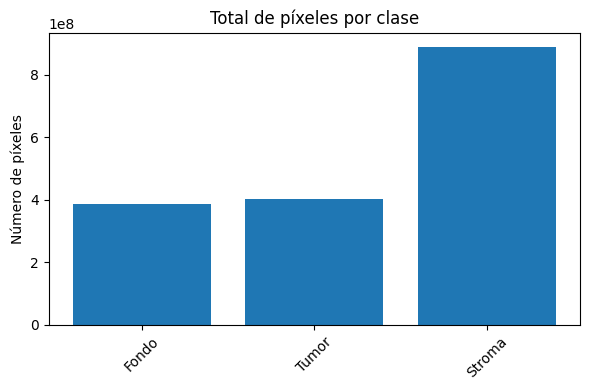

In [1]:
import os
import glob
import logging
from concurrent.futures import ThreadPoolExecutor, as_completed

import cv2
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

# ------------------------------------
# CONFIGURACIÓN
# ------------------------------------
SRC_DIR     = r"C:\Temp\patches_2048\HC22B0006126_HEmascaras_tumor_oversampled_balanced"
SRC_DIR = r"\\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\imagenes\patches_2048\HC22B0006126_HE"

NUM_WORKERS = 8  # Ajustar al número de hilos deseado
LOG_EVERY   = 100

# Setup logging
def setup_logger():
    logging.basicConfig(
        level=logging.INFO,
        format='[%(asctime)s] %(levelname)s: %(message)s',
        datefmt='%H:%M:%S'
    )
    return logging.getLogger()

logger = setup_logger()

# ------------------------------------
# FUNCIONES DE PROCESADO
# ------------------------------------
def process_mask(m_path):
    """
    Lee una máscara y devuelve un diccionario con el recuento de píxeles por clase
    Clases: 0=fondo, 1=tumor, 2=stroma
    """
    mask = cv2.imread(m_path, cv2.IMREAD_UNCHANGED)
    if mask is None:
        logger.warning(f"No pude leer {m_path}")
        return None
    counts = {
        0: int(np.sum(mask == 0)),
        1: int(np.sum(mask == 1)),
        2: int(np.sum(mask == 2))
    }
    return counts

# ------------------------------------
# EJECUCIÓN PRINCIPAL
# ------------------------------------
if __name__ == '__main__':
    # 1) Listar rutas de máscaras
    mask_paths = sorted(glob.glob(os.path.join(SRC_DIR, 'mask_*.png')))
    if not mask_paths:
        logger.error(f"No se encontraron máscaras en {SRC_DIR}")
        exit(1)

    # 2) Procesamiento paralelo
    total_counts = {0: 0, 1: 0, 2: 0}

    with ThreadPoolExecutor(max_workers=NUM_WORKERS) as executor:
        futures = {executor.submit(process_mask, mp): mp for mp in mask_paths}
        for idx, future in enumerate(tqdm(as_completed(futures), total=len(futures), desc='Contando máscaras')):
            res = future.result()
            if res:
                for cls, cnt in res.items():
                    total_counts[cls] += cnt
            if (idx + 1) % LOG_EVERY == 0:
                logger.info(f"Procesadas {idx+1}/{len(mask_paths)} máscaras")

    # 3) Mostrar resultados totales
    clases = {0: 'Fondo', 1: 'Tumor', 2: 'Stroma'}
    logger.info("=== Recuento total de píxeles por clase ===")
    for cls, cnt in total_counts.items():
        logger.info(f"{clases[cls]} ({cls}): {cnt}")

    # 4) Gráfico de barras: total de píxeles por clase
    plt.figure(figsize=(6,4))
    plt.bar([clases[c] for c in total_counts], [total_counts[c] for c in total_counts])
    plt.title("Total de píxeles por clase")
    plt.ylabel("Número de píxeles")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

Analyzing patches: 100%|███████████████████████████████████████████████████████████| 2003/2003 [03:40<00:00,  9.07it/s]


                         count        mean        std        min         25%  \
prop_background         2003.0    0.216448   0.304043   0.000005    0.018029   
prop_front_of_invasion  2003.0    0.279994   0.259395   0.000000    0.052804   
prop_stroma             2003.0    0.503558   0.280261   0.000003    0.276304   
mean_gray               2003.0  139.337424  30.038541  83.776908  120.453204   
mean_hematoxylin        2003.0    0.163348   0.042294   0.044947    0.133512   
mean_eosin              2003.0    0.188778   0.077333   0.000012    0.148384   

                               50%         75%         max  
prop_background           0.055491    0.291489    0.999997  
prop_front_of_invasion    0.226156    0.455616    0.981251  
prop_stroma               0.510814    0.726381    0.991208  
mean_gray               129.948049  154.917417  238.594851  
mean_hematoxylin          0.168427    0.194349    0.289979  
mean_eosin                0.215398    0.241872    0.320498  


C:\Users\Confocal\AppData\Local\Temp\ipykernel_10820\2964114788.py:99: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[0].boxplot([df[c] for c in ["prop_background","prop_front_of_invasion","prop_stroma"]],
C:\Users\Confocal\AppData\Local\Temp\ipykernel_10820\2964114788.py:106: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[1].boxplot([df[c] for c in ["mean_gray","mean_hematoxylin","mean_eosin"]],
C:\Users\Confocal\AppData\Local\Temp\ipykernel_10820\2964114788.py:153: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax.boxplot(data, labels=["Q1","Q2","Q3","Q4"],


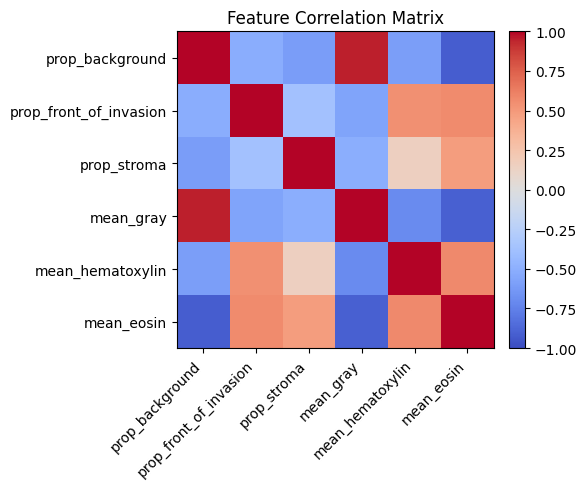

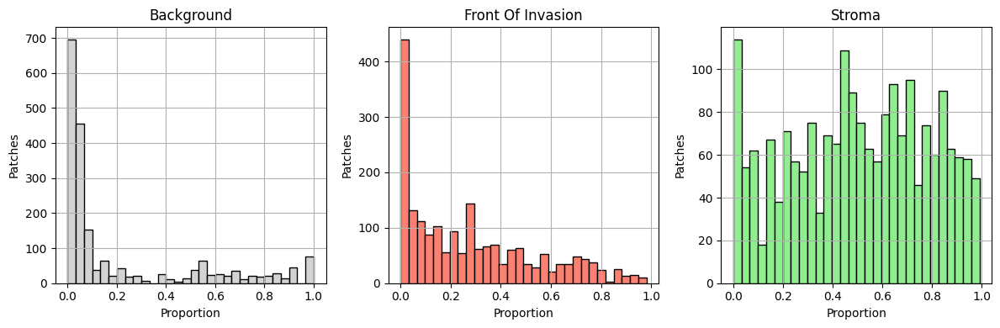

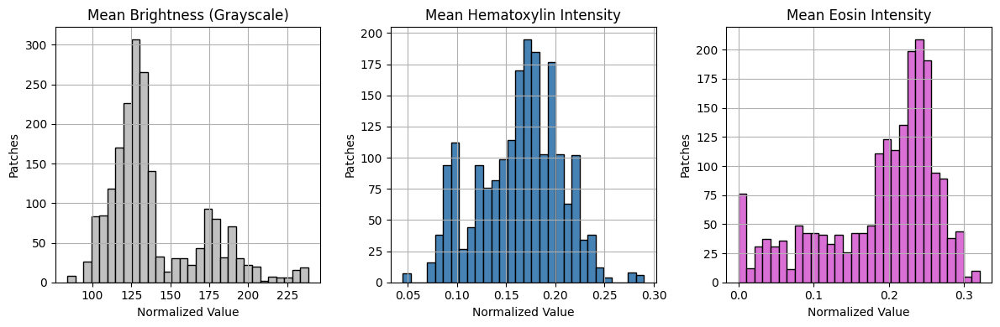

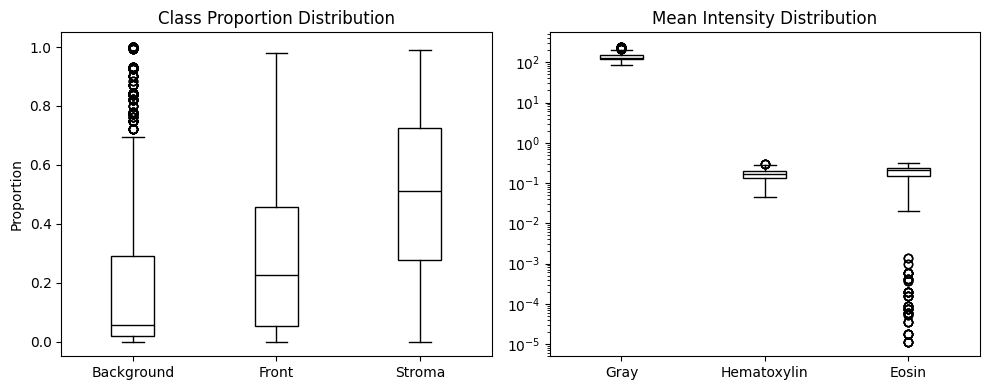

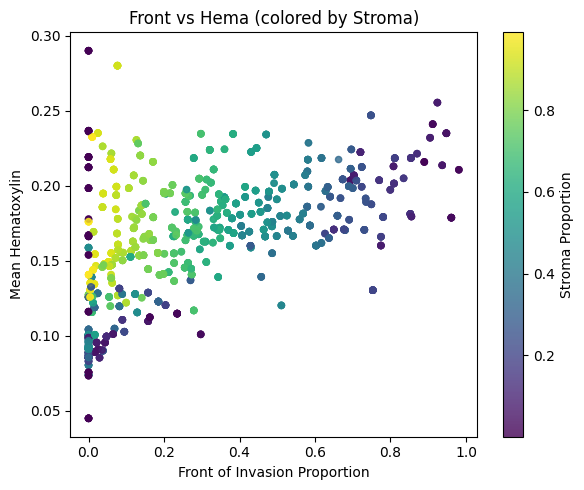

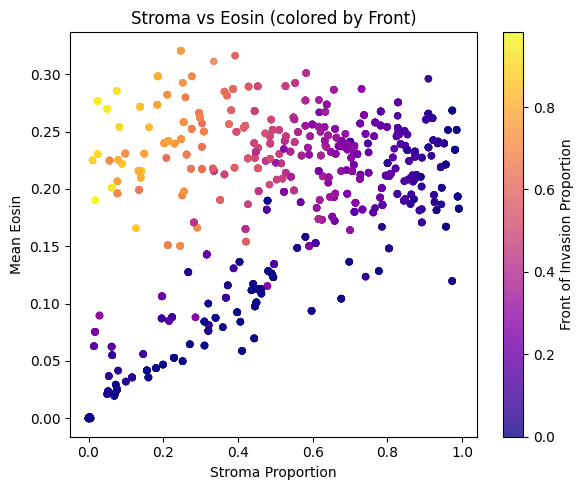

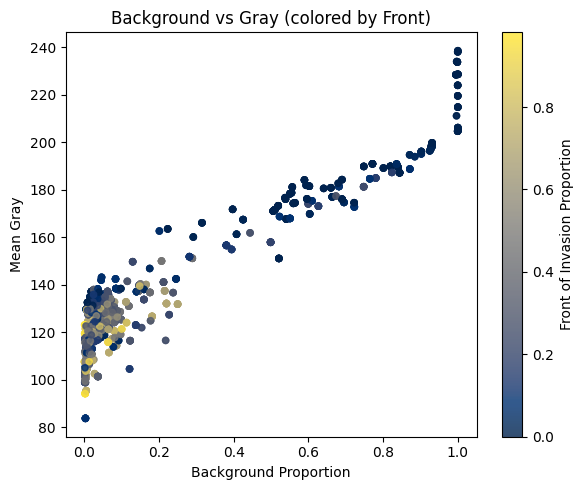

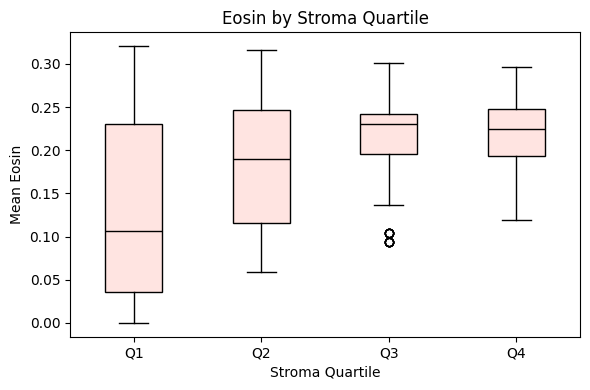

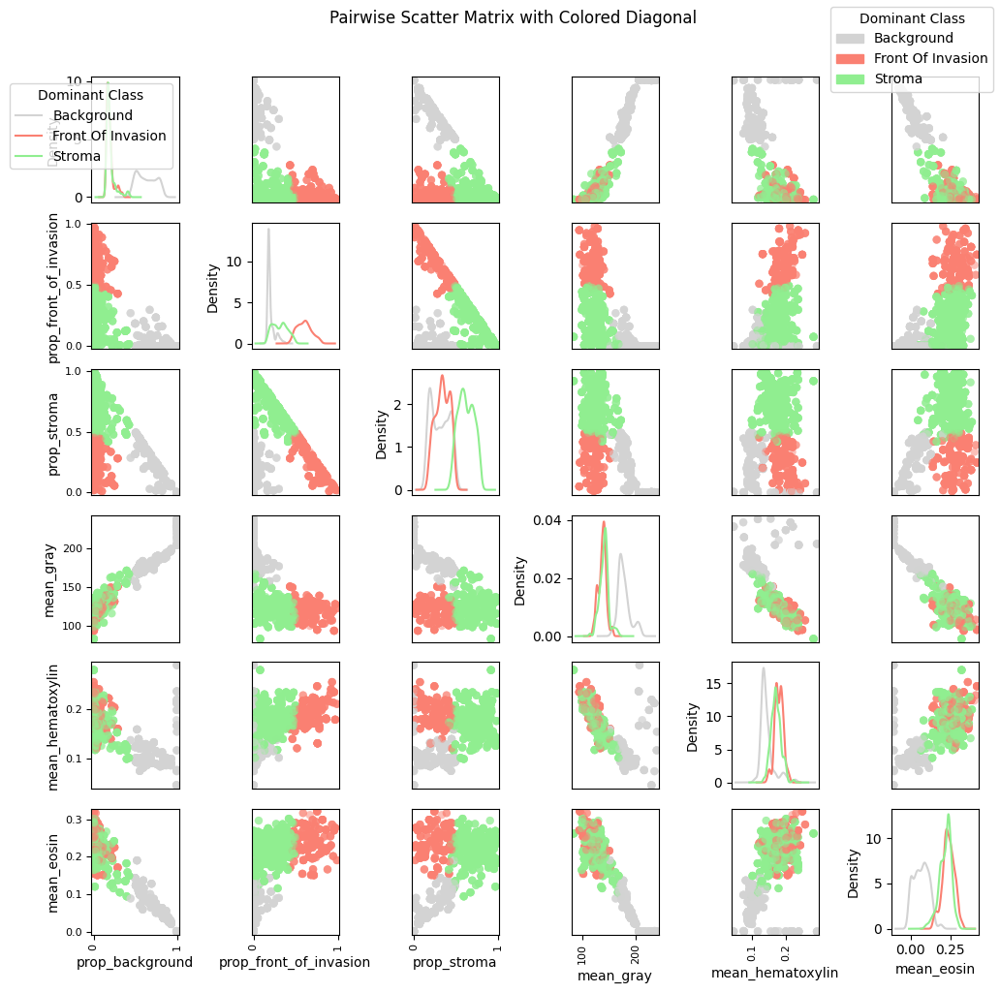

In [17]:
import os
import glob
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm
from skimage.color import rgb2hed
from pandas.plotting import scatter_matrix

# Paths
initial_dir = r"\\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\imagenes\patches_2048\HC22B0006126_HE"
final_dir   = r"C:\Temp\patches_2048\HC22B0006126_HEmascaras_tumor_oversampled_balanced"

# Class labels
class_labels = {0: "background", 1: "front_of_invasion", 2: "stroma"}

def analyze_patch(mpath):
    """Read mask + patch; compute pixel counts, proportions, grayscale and H/E intensities."""
    pid = os.path.splitext(os.path.basename(mpath))[0].split('_')[1]
    mask = cv2.imread(mpath, cv2.IMREAD_UNCHANGED)
    total = mask.size
    counts = {class_labels[c]: int((mask==c).sum()) for c in class_labels}
    props  = {f"prop_{class_labels[c]}": counts[class_labels[c]]/total for c in class_labels}
    img = cv2.cvtColor(cv2.imread(mpath.replace("mask_","patch_")), cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hed = rgb2hed(img/255.0)
    hema = hed[:,:,0]; eos = hed[:,:,1]
    return {
        "patch_id": pid,
        **counts,
        **props,
        "mean_gray": gray.mean(),
        "std_gray":  gray.std(),
        "mean_hematoxylin": np.clip((hema-hema.min())/(hema.max()-hema.min()),0,1).mean(),
        "mean_eosin":      np.clip((eos-eos.min())/(eos.max()-eos.min()),0,1).mean(),
    }

# Load data in parallel
final_masks = sorted(glob.glob(os.path.join(final_dir,"mask_*.png")))
with ThreadPoolExecutor(max_workers=8) as ex:
    futures = [ex.submit(analyze_patch, m) for m in final_masks]
    df = pd.DataFrame([f.result() for f in tqdm(futures, desc="Analyzing patches")])

# --- Convert types ---
for c in df.columns:
    if c!="patch_id":
        df[c] = pd.to_numeric(df[c])

# --- 1) Summary Statistics ---
stats = df[["prop_background","prop_front_of_invasion","prop_stroma",
            "mean_gray","mean_hematoxylin","mean_eosin"]].describe().T
print(stats)

# --- 2) Correlation Heatmap ---
plt.figure(figsize=(6,5))
corr = df[[*stats.index]].corr()
im = plt.imshow(corr, cmap="coolwarm", vmin=-1, vmax=1)
plt.xticks(range(len(corr)), corr.columns, rotation=45, ha="right")
plt.yticks(range(len(corr)), corr.columns)
plt.colorbar(im, fraction=0.046, pad=0.04)
plt.title("Feature Correlation Matrix")
plt.tight_layout()
plt.savefig("correlation_heatmap.svg", format="svg")

# --- 3) Distribution of Proportions ---
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, color in zip(axes,
                          ["prop_background","prop_front_of_invasion","prop_stroma"],
                          ["lightgray","salmon","lightgreen"]):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(col.replace("prop_","{}").replace("_"," ").title().format(''))
    ax.set_xlabel("Proportion")
    ax.set_ylabel("Patches")
plt.tight_layout()
plt.savefig("proportion_histograms.svg", format="svg")

# --- 4) Distribution of Intensities ---
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, color, title in zip(
        axes,
        ["mean_gray","mean_hematoxylin","mean_eosin"],
        ["silver","steelblue","orchid"],
        ["Mean Brightness (Grayscale)",
         "Mean Hematoxylin Intensity",
         "Mean Eosin Intensity"]
    ):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(title)
    ax.set_xlabel("Normalized Value")
    ax.set_ylabel("Patches")
plt.tight_layout()
plt.savefig("intensity_histograms.svg", format="svg")

# --- 5) Boxplots of Proportions & Intensities ---
fig, axes = plt.subplots(1,2, figsize=(10,4))
# proportions
axes[0].boxplot([df[c] for c in ["prop_background","prop_front_of_invasion","prop_stroma"]],
                labels=["Background","Front","Stroma"], patch_artist=True,
                boxprops=dict(facecolor='white',edgecolor='black'),
                medianprops=dict(color='black'))
axes[0].set_title("Class Proportion Distribution")
axes[0].set_ylabel("Proportion")
# intensities
axes[1].boxplot([df[c] for c in ["mean_gray","mean_hematoxylin","mean_eosin"]],
                labels=["Gray","Hematoxylin","Eosin"], patch_artist=True,
                boxprops=dict(facecolor='white',edgecolor='black'),
                medianprops=dict(color='black'))
axes[1].set_title("Mean Intensity Distribution")
axes[1].set_yscale('log')
plt.tight_layout()
plt.savefig("boxplots_props_ints.svg", format="svg")

# --- 6) Scatter Plots: Relationships ---
# A) Front vs Hematoxylin colored by Stroma
plt.figure(figsize=(6,5))
plt.scatter(df["prop_front_of_invasion"], df["mean_hematoxylin"],
            c=df["prop_stroma"], cmap="viridis", s=20, alpha=0.8)
plt.colorbar(label="Stroma Proportion")
plt.xlabel("Front of Invasion Proportion")
plt.ylabel("Mean Hematoxylin")
plt.title("Front vs Hema (colored by Stroma)")
plt.tight_layout()
plt.savefig("scatter_front_hema.svg", format="svg")

# B) Stroma vs Eosin colored by Front
plt.figure(figsize=(6,5))
plt.scatter(df["prop_stroma"], df["mean_eosin"],
            c=df["prop_front_of_invasion"], cmap="plasma", s=20, alpha=0.8)
plt.colorbar(label="Front of Invasion Proportion")
plt.xlabel("Stroma Proportion")
plt.ylabel("Mean Eosin")
plt.title("Stroma vs Eosin (colored by Front)")
plt.tight_layout()
plt.savefig("scatter_stroma_eosin.svg", format="svg")

# C) Background vs Gray colored by Front
plt.figure(figsize=(6,5))
plt.scatter(df["prop_background"], df["mean_gray"],
            c=df["prop_front_of_invasion"], cmap="cividis", s=20, alpha=0.8)
plt.colorbar(label="Front of Invasion Proportion")
plt.xlabel("Background Proportion")
plt.ylabel("Mean Gray")
plt.title("Background vs Gray (colored by Front)")
plt.tight_layout()
plt.savefig("scatter_bg_gray.svg", format="svg")

# --- 7) Intensities by Stroma Quartile ---
df["stroma_q"] = pd.qcut(df["prop_stroma"], 4, labels=["Q1","Q2","Q3","Q4"])
fig, ax = plt.subplots(figsize=(6,4))
data = [df[df.stroma_q==q]["mean_eosin"] for q in ["Q1","Q2","Q3","Q4"]]
ax.boxplot(data, labels=["Q1","Q2","Q3","Q4"],
           patch_artist=True, boxprops=dict(facecolor="mistyrose",edgecolor="black"),
           medianprops=dict(color='black'))
ax.set_xlabel("Stroma Quartile")
ax.set_ylabel("Mean Eosin")
ax.set_title("Eosin by Stroma Quartile")
plt.tight_layout()
plt.savefig("eosin_by_stroma_box.svg", format="svg")

# --- 8) Pairwise Scatter Matrix with Colored Diagonal Distributions ---
# 8.1) Determine dominant class for each patch
features = [
    'prop_background',
    'prop_front_of_invasion',
    'prop_stroma',
    'mean_gray',
    'mean_hematoxylin',
    'mean_eosin'
]
df['dominant_class'] = df[[
    'prop_background',
    'prop_front_of_invasion',
    'prop_stroma'
]].idxmax(axis=1)

# 8.2) Color map for each class
color_map = {
    'prop_background':       'lightgray',
    'prop_front_of_invasion':'salmon',
    'prop_stroma':           'lightgreen'
}
# 8.3) Create scatter matrix without diagonal
sm = scatter_matrix(
    df[features],
    alpha=0.5,
    figsize=(10,10),
    diagonal=None,
    marker='o',
    hist_kwds={'bins':20},
    color=df['color'] if 'color' in df.columns else df['dominant_class'].map(color_map)
)

# 8.4) Plot colored distributions on diagonal
groups = {
    cls: df[df['dominant_class'] == cls]
    for cls in ['prop_background','prop_front_of_invasion','prop_stroma']
}
for i, feat in enumerate(features):
    ax = sm[i, i]
    ax.clear()
    for cls, data in groups.items():
        series = data[feat]
        series.plot(kind='kde', ax=ax, color=color_map[cls], label=cls.replace('prop_','').replace('_',' ').title())
    ax.set_xlabel(feat)
    if i == 0:
        ax.legend(title='Dominant Class', loc='best')

# 8.5) Add manual legend for scatter points
import matplotlib.patches as mpatches
handles = [
    mpatches.Patch(color=color_map[k], label=k.replace('prop_','').replace('_',' ').title())
    for k in color_map
]
plt.gcf().legend(
    handles=handles,
    loc='upper right',
    title='Dominant Class'
)

plt.suptitle("Pairwise Scatter Matrix with Colored Diagonal", y=1.02)
plt.tight_layout()
plt.savefig("pairwise_scatter_matrix_colored_diagonal.svg", format="svg")

Analyzing patches: 100%|███████████████████████████████████████████████████████████| 2003/2003 [03:41<00:00,  9.03it/s]


                         count        mean        std        min         25%  \
prop_background         2003.0    0.216448   0.304043   0.000005    0.018029   
prop_front_of_invasion  2003.0    0.279994   0.259395   0.000000    0.052804   
prop_stroma             2003.0    0.503558   0.280261   0.000003    0.276304   
mean_gray               2003.0  139.337424  30.038541  83.776908  120.453204   
mean_hematoxylin        2003.0    0.163348   0.042294   0.044947    0.133512   
mean_eosin              2003.0    0.188778   0.077333   0.000012    0.148384   

                               50%         75%         max  
prop_background           0.055491    0.291489    0.999997  
prop_front_of_invasion    0.226156    0.455616    0.981251  
prop_stroma               0.510814    0.726381    0.991208  
mean_gray               129.948049  154.917417  238.594851  
mean_hematoxylin          0.168427    0.194349    0.289979  
mean_eosin                0.215398    0.241872    0.320498  


C:\Users\Confocal\AppData\Local\Temp\ipykernel_10820\3521290397.py:124: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[0].boxplot([df[c] for c in ["prop_background","prop_front_of_invasion","prop_stroma"]],
C:\Users\Confocal\AppData\Local\Temp\ipykernel_10820\3521290397.py:131: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[1].boxplot([df[c] for c in ["mean_gray","mean_hematoxylin","mean_eosin"]],
C:\Users\Confocal\AppData\Local\Temp\ipykernel_10820\3521290397.py:178: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[0].boxplot([df[df.stroma_quartile==q]["mean_eosin"] for q in quartiles.cat.categories],
C:\Us

All plots generated and saved to disk.


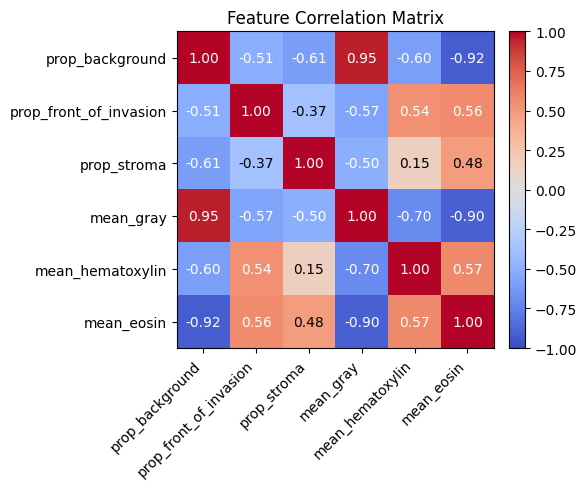

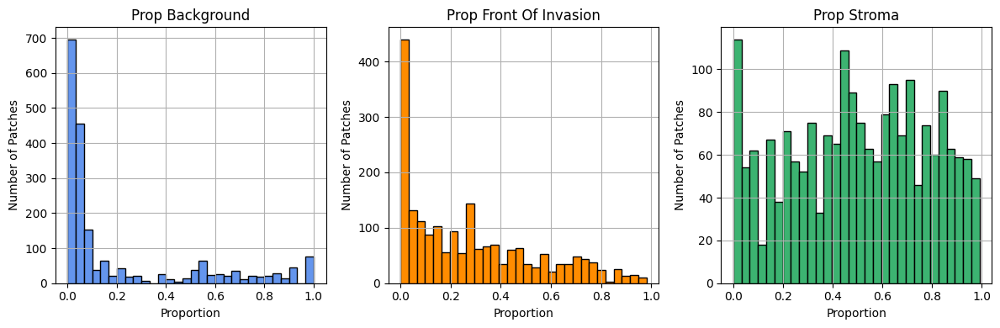

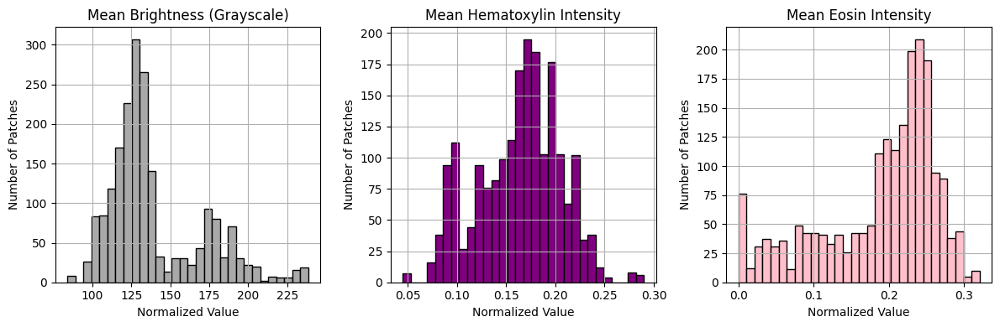

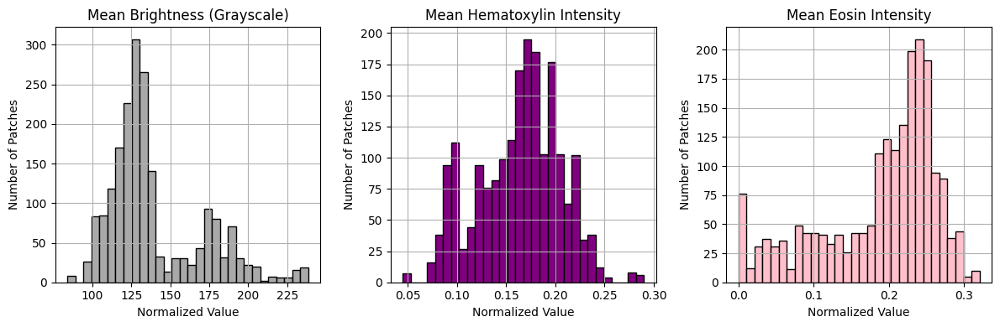

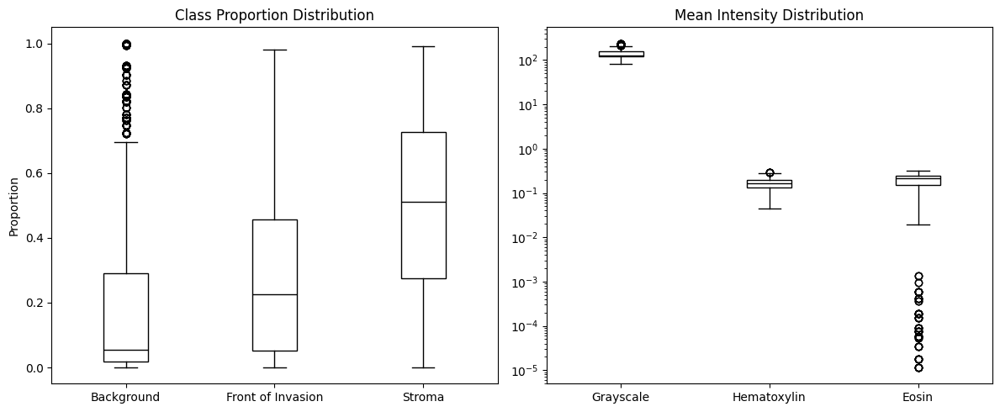

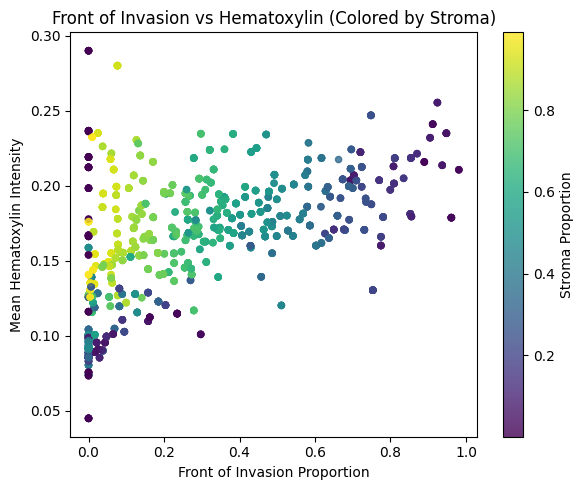

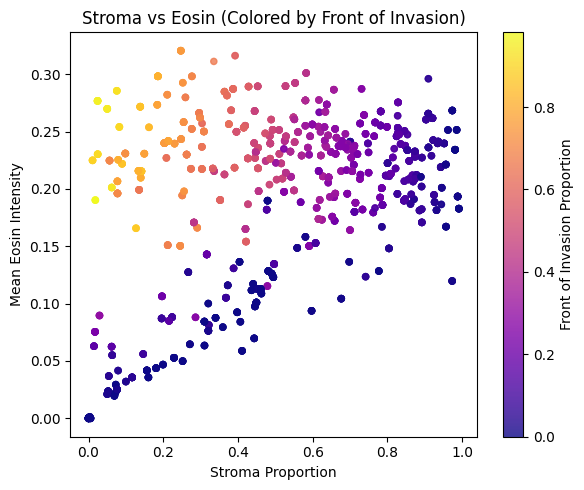

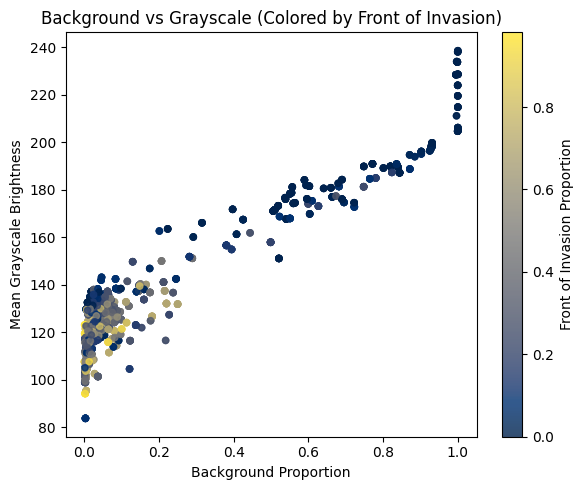

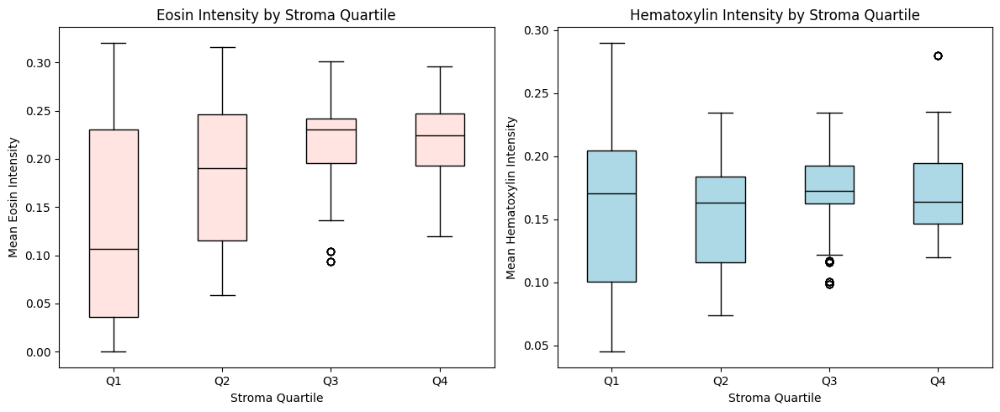

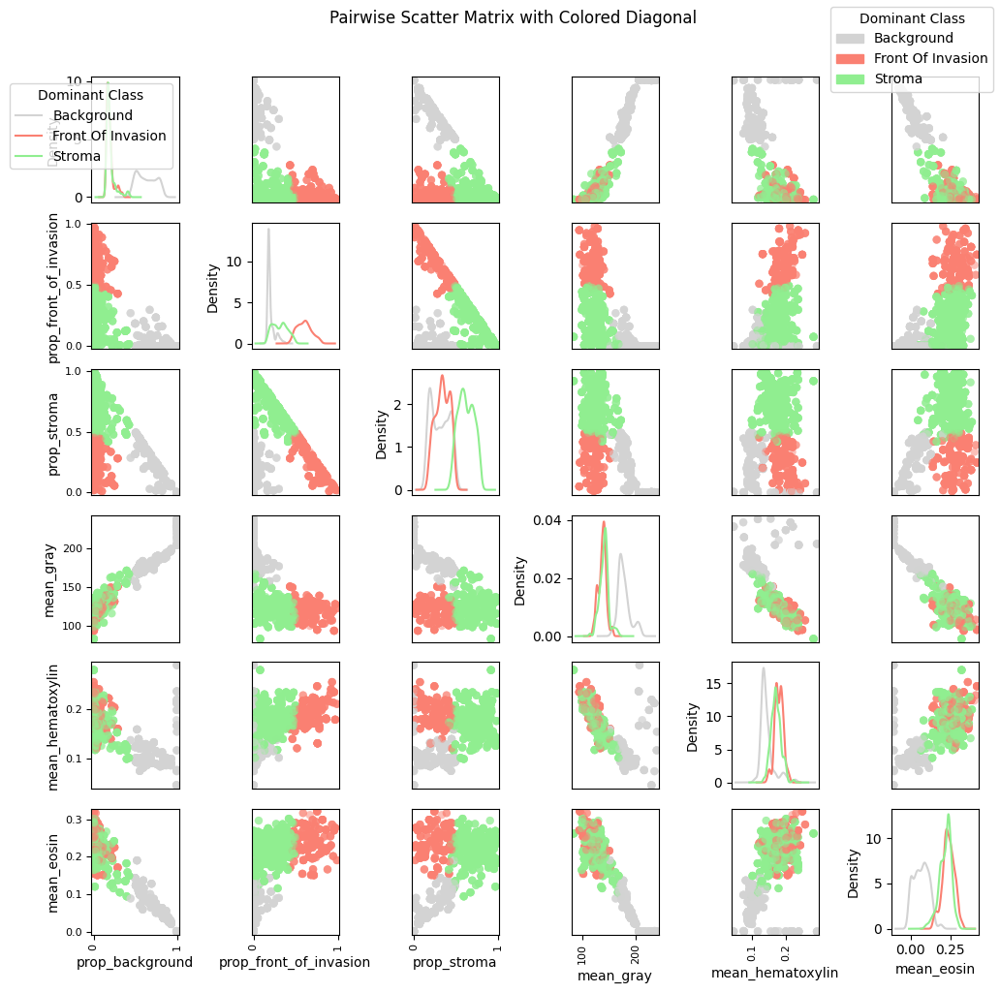

In [21]:
import os
import glob
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import itertools
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm
from skimage.color import rgb2hed
from pandas.plotting import scatter_matrix

# --- Paths ---
initial_dir = r"\\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\imagenes\patches_2048\HC22B0006126_HE"
final_dir   = r"C:\Temp\patches_2048\HC22B0006126_HEmascaras_tumor_oversampled_balanced"

# --- Class labels ---
class_labels = {0: "background", 1: "front_of_invasion", 2: "stroma"}

def analyze_patch(mpath):
    """Read mask + patch; compute pixel counts, proportions, grayscale and Hematoxylin/Eosin intensities."""
    pid = os.path.splitext(os.path.basename(mpath))[0].split('_')[1]
    mask = cv2.imread(mpath, cv2.IMREAD_UNCHANGED)
    total = mask.size
    counts = {class_labels[c]: int((mask==c).sum()) for c in class_labels}
    props  = {f"prop_{class_labels[c]}": counts[class_labels[c]]/total for c in class_labels}
    img = cv2.cvtColor(cv2.imread(mpath.replace("mask_","patch_")), cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hed = rgb2hed(img/255.0)
    hematoxylin = hed[:,:,0]
    eosin       = hed[:,:,1]
    return {
        "patch_id": pid,
        **counts,
        **props,
        "mean_gray": gray.mean(),
        "std_gray":  gray.std(),
        "mean_hematoxylin": np.clip((hematoxylin-hematoxylin.min())/(hematoxylin.max()-hematoxylin.min()),0,1).mean(),
        "mean_eosin":      np.clip((eosin-eosin.min())/(eosin.max()-eosin.min()),0,1).mean(),
    }

# --- Load data in parallel ---
final_masks = sorted(glob.glob(os.path.join(final_dir, "mask_*.png")))
with ThreadPoolExecutor(max_workers=8) as ex:
    futures = [ex.submit(analyze_patch, m) for m in final_masks]
    df = pd.DataFrame([f.result() for f in tqdm(futures, desc="Analyzing patches")])

# --- Convert types ---
for c in df.columns:
    if c != "patch_id":
        df[c] = pd.to_numeric(df[c])

# --- 1) Summary Statistics ---
stats = df[["prop_background","prop_front_of_invasion","prop_stroma",
            "mean_gray","mean_hematoxylin","mean_eosin"]].describe().T
print(stats)

# --- 2) Correlation Heatmap with Annotations ---
plt.figure(figsize=(6,5))
corr = df[stats.index].corr()
im = plt.imshow(corr, cmap="coolwarm", vmin=-1, vmax=1)
plt.xticks(range(len(corr)), corr.columns, rotation=45, ha="right")
plt.yticks(range(len(corr)), corr.columns)
# annotate
for i, j in itertools.product(range(len(corr)), range(len(corr))):
    text = f"{corr.iloc[i,j]:.2f}"
    plt.text(j, i, text, ha="center", va="center",
             color="white" if abs(corr.iloc[i,j])>0.5 else "black")
plt.colorbar(im, fraction=0.046, pad=0.04)
plt.title("Feature Correlation Matrix")
plt.tight_layout()
plt.savefig("correlation_heatmap_annotated.svg", format="svg")

# --- 3) Distribution of Proportions (Histograms) ---
proportion_colors = ['cornflowerblue', 'darkorange', 'mediumseagreen']  # Nuevo esquema para background, front_of_invasion y stroma
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, color in zip(axes, ["prop_background","prop_front_of_invasion","prop_stroma"], proportion_colors):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(col.replace("prop_","Prop ").replace("_"," ").title())
    ax.set_xlabel("Proportion")
    ax.set_ylabel("Number of Patches")
plt.tight_layout()
plt.savefig("proportion_histograms.svg", format="svg")

# --- 4) Distribution of Intensities (Histograms) ---
intensity_colors = ['darkgray', 'purple', 'pink']  # Grayscale, Hematoxylin (morado), Eosin (rosa)
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, title, color in zip(
        axes,
        ["mean_gray","mean_hematoxylin","mean_eosin"],
        ["Mean Brightness (Grayscale)",
         "Mean Hematoxylin Intensity",
         "Mean Eosin Intensity"],
        intensity_colors
    ):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(title)
    ax.set_xlabel("Normalized Value")
    ax.set_ylabel("Number of Patches")
plt.tight_layout()
plt.savefig("intensity_histograms.svg", format="svg")

# --- 5) Boxplots of Proportions & Intensities --- of Intensities (Histograms) ---
intensity_colors = ['darkgray','purple','pink']  # Grayscale, Hematoxylin, Eosin
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, title, color in zip(
        axes,
        ["mean_gray","mean_hematoxylin","mean_eosin"],
        ["Mean Brightness (Grayscale)",
         "Mean Hematoxylin Intensity",
         "Mean Eosin Intensity"],
        intensity_colors
    ):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(title)
    ax.set_xlabel("Normalized Value")
    ax.set_ylabel("Number of Patches")
plt.tight_layout()
plt.savefig("intensity_histograms.svg", format="svg")

# --- 5) Boxplots of Proportions & Intensities ---
fig, axes = plt.subplots(1,2, figsize=(12,5))
# Proportions
axes[0].boxplot([df[c] for c in ["prop_background","prop_front_of_invasion","prop_stroma"]],
                labels=["Background","Front of Invasion","Stroma"], patch_artist=True,
                boxprops=dict(facecolor='white',edgecolor='black'),
                medianprops=dict(color='black'))
axes[0].set_title("Class Proportion Distribution")
axes[0].set_ylabel("Proportion")
# Intensities
axes[1].boxplot([df[c] for c in ["mean_gray","mean_hematoxylin","mean_eosin"]],
                labels=["Grayscale","Hematoxylin","Eosin"], patch_artist=True,
                boxprops=dict(facecolor='white',edgecolor='black'),
                medianprops=dict(color='black'))
axes[1].set_title("Mean Intensity Distribution")
axes[1].set_yscale('log')
plt.tight_layout()
plt.savefig("boxplots_props_ints.svg", format="svg")

# --- 6) Scatter Plots: Relationships ---
# A) Front of Invasion vs Hematoxylin colored by Stroma
plt.figure(figsize=(6,5))
plt.scatter(df["prop_front_of_invasion"], df["mean_hematoxylin"],
            c=df["prop_stroma"], cmap="viridis", s=20, alpha=0.8)
plt.colorbar(label="Stroma Proportion")
plt.xlabel("Front of Invasion Proportion")
plt.ylabel("Mean Hematoxylin Intensity")
plt.title("Front of Invasion vs Hematoxylin (Colored by Stroma)")
plt.tight_layout()
plt.savefig("scatter_front_hematoxylin.svg", format="svg")

# B) Stroma vs Eosin colored by Front of Invasion
plt.figure(figsize=(6,5))
plt.scatter(df["prop_stroma"], df["mean_eosin"],
            c=df["prop_front_of_invasion"], cmap="plasma", s=20, alpha=0.8)
plt.colorbar(label="Front of Invasion Proportion")
plt.xlabel("Stroma Proportion")
plt.ylabel("Mean Eosin Intensity")
plt.title("Stroma vs Eosin (Colored by Front of Invasion)")
plt.tight_layout()
plt.savefig("scatter_stroma_eosin.svg", format="svg")

# C) Background vs Grayscale colored by Front of Invasion
plt.figure(figsize=(6,5))
plt.scatter(df["prop_background"], df["mean_gray"],
            c=df["prop_front_of_invasion"], cmap="cividis", s=20, alpha=0.8)
plt.colorbar(label="Front of Invasion Proportion")
plt.xlabel("Background Proportion")
plt.ylabel("Mean Grayscale Brightness")
plt.title("Background vs Grayscale (Colored by Front of Invasion)")
plt.tight_layout()
plt.savefig("scatter_background_grayscale.svg", format="svg")

# --- 7) Intensities by Stroma Quartile ---
quartiles = pd.qcut(df["prop_stroma"], 4, labels=["Q1","Q2","Q3","Q4"])
df["stroma_quartile"] = quartiles
fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].boxplot([df[df.stroma_quartile==q]["mean_eosin"] for q in quartiles.cat.categories],
                labels=quartiles.cat.categories, patch_artist=True,
                boxprops=dict(facecolor='mistyrose',edgecolor='black'),
                medianprops=dict(color='black'))
axes[0].set_title("Eosin Intensity by Stroma Quartile")
axes[0].set_xlabel("Stroma Quartile")
axes[0].set_ylabel("Mean Eosin Intensity")
axes[1].boxplot([df[df.stroma_quartile==q]["mean_hematoxylin"] for q in quartiles.cat.categories],
                labels=quartiles.cat.categories, patch_artist=True,
                boxprops=dict(facecolor='lightblue',edgecolor='black'),
                medianprops=dict(color='black'))
axes[1].set_title("Hematoxylin Intensity by Stroma Quartile")
axes[1].set_xlabel("Stroma Quartile")
axes[1].set_ylabel("Mean Hematoxylin Intensity")
plt.tight_layout()
plt.savefig("intensities_by_stroma_quartile.svg", format="svg")

# --- 8) Pairwise Scatter Matrix with Colored Diagonal Distributions ---
df['dominant_class'] = df[[
    'prop_background', 'prop_front_of_invasion', 'prop_stroma'
]].idxmax(axis=1)
color_map = {
    'prop_background':       'lightgray',
    'prop_front_of_invasion':'salmon',
    'prop_stroma':           'lightgreen'
}
features = ['prop_background','prop_front_of_invasion','prop_stroma',
            'mean_gray','mean_hematoxylin','mean_eosin']
sm = scatter_matrix(
    df[features],
    alpha=0.5,
    figsize=(10,10),
    diagonal=None,
    marker='o',
    hist_kwds={'bins':20},
    color=df['dominant_class'].map(color_map)
)
for i, feat in enumerate(features):
    ax = sm[i, i]
    ax.clear()
    for cls, group in df.groupby('dominant_class'):
        group[feat].plot(kind='kde', ax=ax, color=color_map[cls], label=cls.replace('prop_','').replace('_',' ').title())
    ax.set_xlabel(feat)
    if i==0:
        ax.legend(title='Dominant Class', loc='best')
import matplotlib.patches as mpatches
handles = [mpatches.Patch(color=color_map[k], label=k.replace('prop_','').replace('_',' ').title())
           for k in color_map]
plt.gcf().legend(handles=handles, loc='upper right', title='Dominant Class')
plt.suptitle("Pairwise Scatter Matrix with Colored Diagonal", y=1.02)
plt.tight_layout()
plt.savefig("pairwise_scatter_matrix_colored_diagonal.svg", format="svg")

print("All plots generated and saved to disk.")


In [26]:
print(f"Total de parches analizados: {len(df)}")


Total de parches analizados: 2003


Analyzing patches: 100%|███████████████████████████████████████████████████████████| 2003/2003 [03:40<00:00,  9.10it/s]


                         count        mean        std        min         25%  \
prop_background         2003.0    0.216448   0.304043   0.000005    0.018029   
prop_front_of_invasion  2003.0    0.279994   0.259395   0.000000    0.052804   
prop_stroma             2003.0    0.503558   0.280261   0.000003    0.276304   
mean_gray               2003.0  139.337424  30.038541  83.776908  120.453204   
mean_hematoxylin        2003.0    0.163348   0.042294   0.044947    0.133512   
mean_eosin              2003.0    0.188778   0.077333   0.000012    0.148384   

                               50%         75%         max  
prop_background           0.055491    0.291489    0.999997  
prop_front_of_invasion    0.226156    0.455616    0.981251  
prop_stroma               0.510814    0.726381    0.991208  
mean_gray               129.948049  154.917417  238.594851  
mean_hematoxylin          0.168427    0.194349    0.289979  
mean_eosin                0.215398    0.241872    0.320498  


C:\Users\Confocal\AppData\Local\Temp\ipykernel_33984\2594047496.py:124: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[0].boxplot([df[c] for c in ["prop_background","prop_front_of_invasion","prop_stroma"]],
C:\Users\Confocal\AppData\Local\Temp\ipykernel_33984\2594047496.py:131: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[1].boxplot([df[c] for c in ["mean_gray","mean_hematoxylin","mean_eosin"]],
C:\Users\Confocal\AppData\Local\Temp\ipykernel_33984\2594047496.py:178: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[0].boxplot([df[df.stroma_quartile==q]["mean_eosin"] for q in quartiles.cat.categories],
C:\Us

TypeError: 'Text' object is not callable

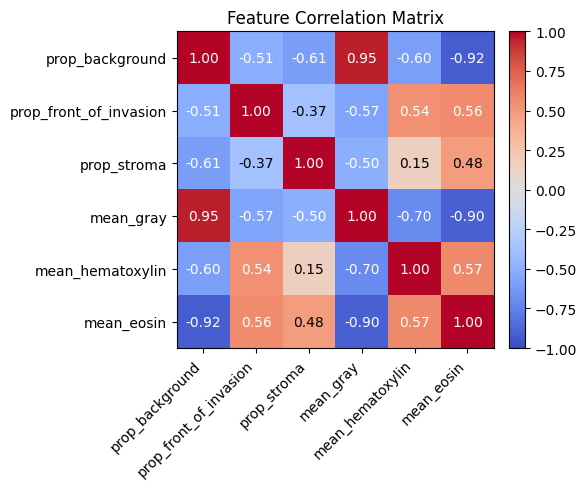

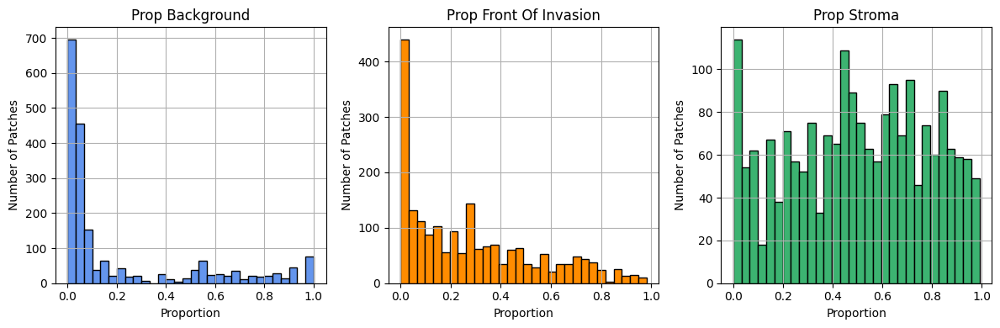

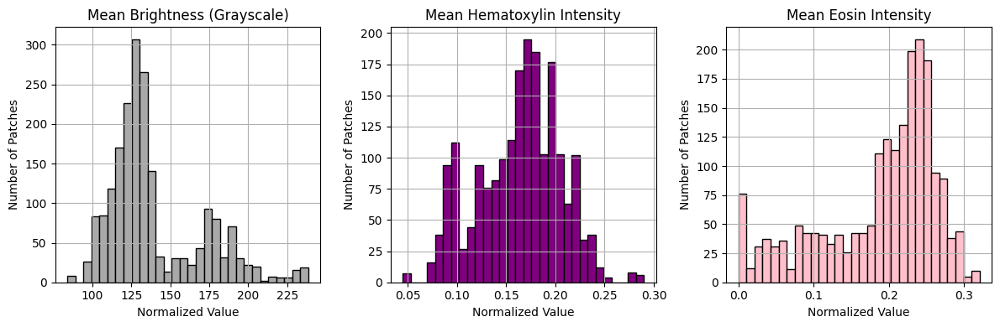

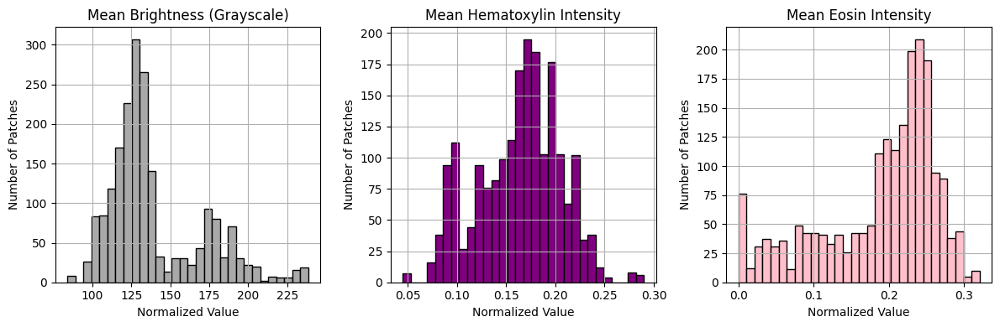

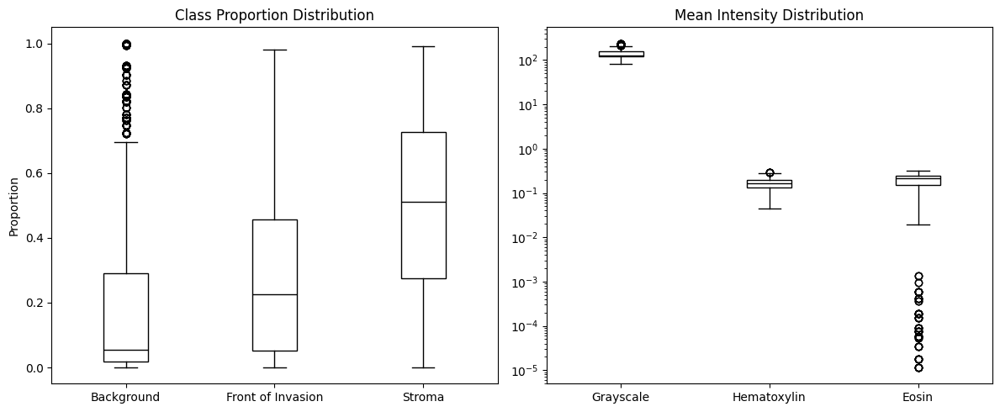

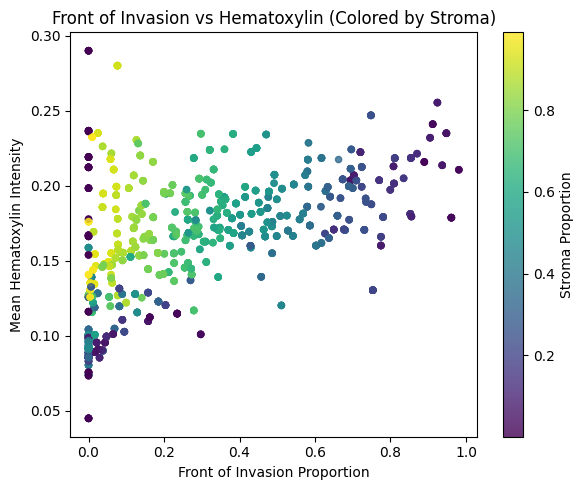

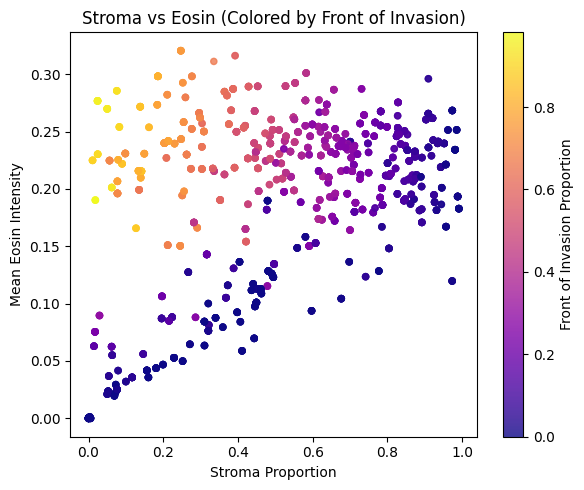

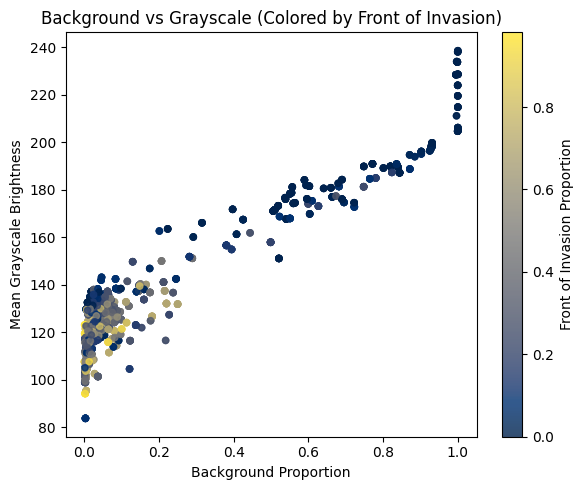

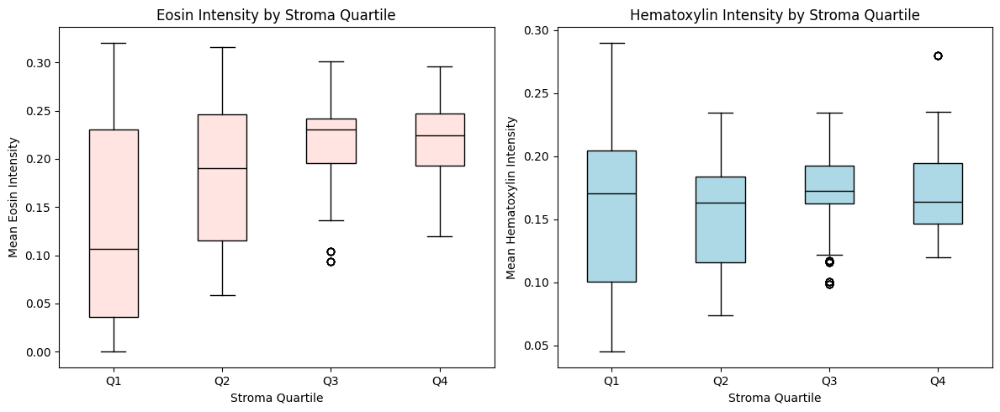

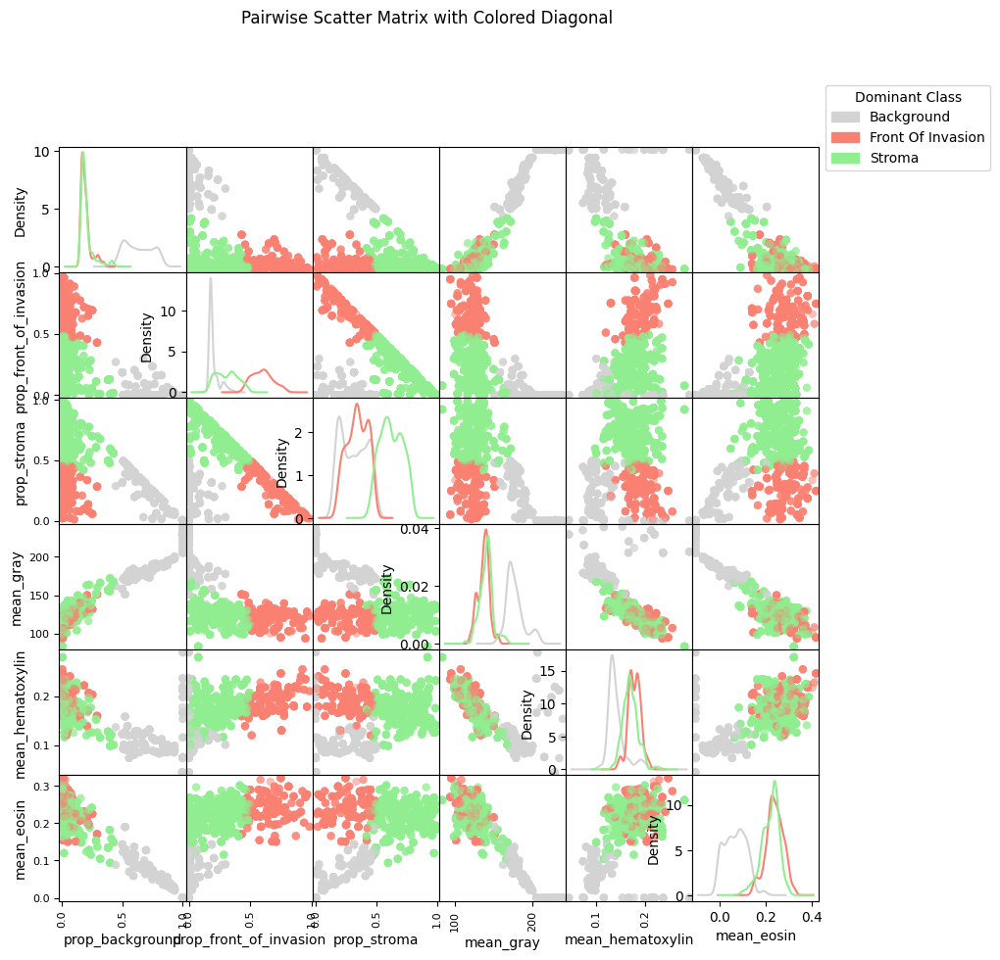

In [1]:
import os
import glob
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import itertools
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm
from skimage.color import rgb2hed
from pandas.plotting import scatter_matrix

# --- Paths ---
initial_dir = r"\\imgserver.cnio.es\IMAGES\CONFOCAL\IA\CMU\tfm_colab\patrones_invasion\OME_PATRONES_QPATH\imagenes\patches_2048\HC22B0006126_HE"
final_dir   = r"C:\Temp\patches_2048\HC22B0006126_HEmascaras_tumor_oversampled_balanced"

# --- Class labels ---
class_labels = {0: "background", 1: "front_of_invasion", 2: "stroma"}

def analyze_patch(mpath):
    """Read mask + patch; compute pixel counts, proportions, grayscale and Hematoxylin/Eosin intensities."""
    pid = os.path.splitext(os.path.basename(mpath))[0].split('_')[1]
    mask = cv2.imread(mpath, cv2.IMREAD_UNCHANGED)
    total = mask.size
    counts = {class_labels[c]: int((mask==c).sum()) for c in class_labels}
    props  = {f"prop_{class_labels[c]}": counts[class_labels[c]]/total for c in class_labels}
    img = cv2.cvtColor(cv2.imread(mpath.replace("mask_","patch_")), cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hed = rgb2hed(img/255.0)
    hematoxylin = hed[:,:,0]
    eosin       = hed[:,:,1]
    return {
        "patch_id": pid,
        **counts,
        **props,
        "mean_gray": gray.mean(),
        "std_gray":  gray.std(),
        "mean_hematoxylin": np.clip((hematoxylin-hematoxylin.min())/(hematoxylin.max()-hematoxylin.min()),0,1).mean(),
        "mean_eosin":      np.clip((eosin-eosin.min())/(eosin.max()-eosin.min()),0,1).mean(),
    }

# --- Load data in parallel ---
final_masks = sorted(glob.glob(os.path.join(final_dir, "mask_*.png")))
with ThreadPoolExecutor(max_workers=8) as ex:
    futures = [ex.submit(analyze_patch, m) for m in final_masks]
    df = pd.DataFrame([f.result() for f in tqdm(futures, desc="Analyzing patches")])

# --- Convert types ---
for c in df.columns:
    if c != "patch_id":
        df[c] = pd.to_numeric(df[c])

# --- 1) Summary Statistics ---
stats = df[["prop_background","prop_front_of_invasion","prop_stroma",
            "mean_gray","mean_hematoxylin","mean_eosin"]].describe().T
print(stats)

# --- 2) Correlation Heatmap with Annotations ---
plt.figure(figsize=(6,5))
corr = df[stats.index].corr()
im = plt.imshow(corr, cmap="coolwarm", vmin=-1, vmax=1)
plt.xticks(range(len(corr)), corr.columns, rotation=45, ha="right")
plt.yticks(range(len(corr)), corr.columns)
# annotate
for i, j in itertools.product(range(len(corr)), range(len(corr))):
    text = f"{corr.iloc[i,j]:.2f}"
    plt.text(j, i, text, ha="center", va="center",
             color="white" if abs(corr.iloc[i,j])>0.5 else "black")
plt.colorbar(im, fraction=0.046, pad=0.04)
plt.title("Feature Correlation Matrix")
plt.tight_layout()
plt.savefig("correlation_heatmap_annotated.svg", format="svg")

# --- 3) Distribution of Proportions (Histograms) ---
proportion_colors = ['cornflowerblue', 'darkorange', 'mediumseagreen']  # Nuevo esquema para background, front_of_invasion y stroma
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, color in zip(axes, ["prop_background","prop_front_of_invasion","prop_stroma"], proportion_colors):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(col.replace("prop_","Prop ").replace("_"," ").title())
    ax.set_xlabel("Proportion")
    ax.set_ylabel("Number of Patches")
plt.tight_layout()
plt.savefig("proportion_histograms.svg", format="svg")

# --- 4) Distribution of Intensities (Histograms) ---
intensity_colors = ['darkgray', 'purple', 'pink']  # Grayscale, Hematoxylin (morado), Eosin (rosa)
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, title, color in zip(
        axes,
        ["mean_gray","mean_hematoxylin","mean_eosin"],
        ["Mean Brightness (Grayscale)",
         "Mean Hematoxylin Intensity",
         "Mean Eosin Intensity"],
        intensity_colors
    ):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(title)
    ax.set_xlabel("Normalized Value")
    ax.set_ylabel("Number of Patches")
plt.tight_layout()
plt.savefig("intensity_histograms.svg", format="svg")

# --- 5) Boxplots of Proportions & Intensities --- of Intensities (Histograms) ---
intensity_colors = ['darkgray','purple','pink']  # Grayscale, Hematoxylin, Eosin
fig, axes = plt.subplots(1,3, figsize=(12,4))
for ax, col, title, color in zip(
        axes,
        ["mean_gray","mean_hematoxylin","mean_eosin"],
        ["Mean Brightness (Grayscale)",
         "Mean Hematoxylin Intensity",
         "Mean Eosin Intensity"],
        intensity_colors
    ):
    df[col].hist(bins=30, ax=ax, color=color, edgecolor="black")
    ax.set_title(title)
    ax.set_xlabel("Normalized Value")
    ax.set_ylabel("Number of Patches")
plt.tight_layout()
plt.savefig("intensity_histograms.svg", format="svg")

# --- 5) Boxplots of Proportions & Intensities ---
fig, axes = plt.subplots(1,2, figsize=(12,5))
# Proportions
axes[0].boxplot([df[c] for c in ["prop_background","prop_front_of_invasion","prop_stroma"]],
                labels=["Background","Front of Invasion","Stroma"], patch_artist=True,
                boxprops=dict(facecolor='white',edgecolor='black'),
                medianprops=dict(color='black'))
axes[0].set_title("Class Proportion Distribution")
axes[0].set_ylabel("Proportion")
# Intensities
axes[1].boxplot([df[c] for c in ["mean_gray","mean_hematoxylin","mean_eosin"]],
                labels=["Grayscale","Hematoxylin","Eosin"], patch_artist=True,
                boxprops=dict(facecolor='white',edgecolor='black'),
                medianprops=dict(color='black'))
axes[1].set_title("Mean Intensity Distribution")
axes[1].set_yscale('log')
plt.tight_layout()
plt.savefig("boxplots_props_ints.svg", format="svg")

# --- 6) Scatter Plots: Relationships ---
# A) Front of Invasion vs Hematoxylin colored by Stroma
plt.figure(figsize=(6,5))
plt.scatter(df["prop_front_of_invasion"], df["mean_hematoxylin"],
            c=df["prop_stroma"], cmap="viridis", s=20, alpha=0.8)
plt.colorbar(label="Stroma Proportion")
plt.xlabel("Front of Invasion Proportion")
plt.ylabel("Mean Hematoxylin Intensity")
plt.title("Front of Invasion vs Hematoxylin (Colored by Stroma)")
plt.tight_layout()
plt.savefig("scatter_front_hematoxylin.svg", format="svg")

# B) Stroma vs Eosin colored by Front of Invasion
plt.figure(figsize=(6,5))
plt.scatter(df["prop_stroma"], df["mean_eosin"],
            c=df["prop_front_of_invasion"], cmap="plasma", s=20, alpha=0.8)
plt.colorbar(label="Front of Invasion Proportion")
plt.xlabel("Stroma Proportion")
plt.ylabel("Mean Eosin Intensity")
plt.title("Stroma vs Eosin (Colored by Front of Invasion)")
plt.tight_layout()
plt.savefig("scatter_stroma_eosin.svg", format="svg")

# C) Background vs Grayscale colored by Front of Invasion
plt.figure(figsize=(6,5))
plt.scatter(df["prop_background"], df["mean_gray"],
            c=df["prop_front_of_invasion"], cmap="cividis", s=20, alpha=0.8)
plt.colorbar(label="Front of Invasion Proportion")
plt.xlabel("Background Proportion")
plt.ylabel("Mean Grayscale Brightness")
plt.title("Background vs Grayscale (Colored by Front of Invasion)")
plt.tight_layout()
plt.savefig("scatter_background_grayscale.svg", format="svg")

# --- 7) Intensities by Stroma Quartile ---
quartiles = pd.qcut(df["prop_stroma"], 4, labels=["Q1","Q2","Q3","Q4"])
df["stroma_quartile"] = quartiles
fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].boxplot([df[df.stroma_quartile==q]["mean_eosin"] for q in quartiles.cat.categories],
                labels=quartiles.cat.categories, patch_artist=True,
                boxprops=dict(facecolor='mistyrose',edgecolor='black'),
                medianprops=dict(color='black'))
axes[0].set_title("Eosin Intensity by Stroma Quartile")
axes[0].set_xlabel("Stroma Quartile")
axes[0].set_ylabel("Mean Eosin Intensity")
axes[1].boxplot([df[df.stroma_quartile==q]["mean_hematoxylin"] for q in quartiles.cat.categories],
                labels=quartiles.cat.categories, patch_artist=True,
                boxprops=dict(facecolor='lightblue',edgecolor='black'),
                medianprops=dict(color='black'))
axes[1].set_title("Hematoxylin Intensity by Stroma Quartile")
axes[1].set_xlabel("Stroma Quartile")
axes[1].set_ylabel("Mean Hematoxylin Intensity")
plt.tight_layout()
plt.savefig("intensities_by_stroma_quartile.svg", format="svg")

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from pandas.plotting import scatter_matrix

# Determine dominant class per row
df['dominant_class'] = df[['prop_background', 'prop_front_of_invasion', 'prop_stroma']].idxmax(axis=1)

# Define colors for each class
color_map = {
    'prop_background':       'lightgray',
    'prop_front_of_invasion':'salmon',
    'prop_stroma':           'lightgreen'
}

# Select features to plot
features = [
    'prop_background',
    'prop_front_of_invasion',
    'prop_stroma',
    'mean_gray',
    'mean_hematoxylin',
    'mean_eosin'
]

# Create the scatter matrix without diagonal plots
sm = scatter_matrix(
    df[features],
    alpha=0.5,
    figsize=(10, 10),
    diagonal=None,
    marker='o',
    hist_kwds={'bins': 20},
    color=df['dominant_class'].map(color_map)
)

# Replace diagonal with KDEs and skip per-axes legend
for i, feat in enumerate(features):
    ax = sm[i, i]
    ax.clear()
    for cls, group in df.groupby('dominant_class'):
        group[feat].plot(
            kind='kde',
            ax=ax,
            color=color_map[cls],
            label=cls.replace('prop_', '').replace('_', ' ').title()
        )
    ax.set_xlabel(feat)

# Create a single, global legend
handles = [
    mpatches.Patch(
        color=color_map[k],
        label=k.replace('prop_', '').replace('_', ' ').title()
    )
    for k in color_map
]
plt.gcf().legend(handles=handles, loc='upper right', title='Dominant Class')
plt.suptitle("Pairwise Scatter Matrix with Colored Diagonal", y=1.02)
plt.tight_layout()
plt.savefig("pairwise_scatter_matrix_colored_diagonal.svg", format="svg")

print("All plots generated and saved to disk.")

All plots generated and saved to disk.


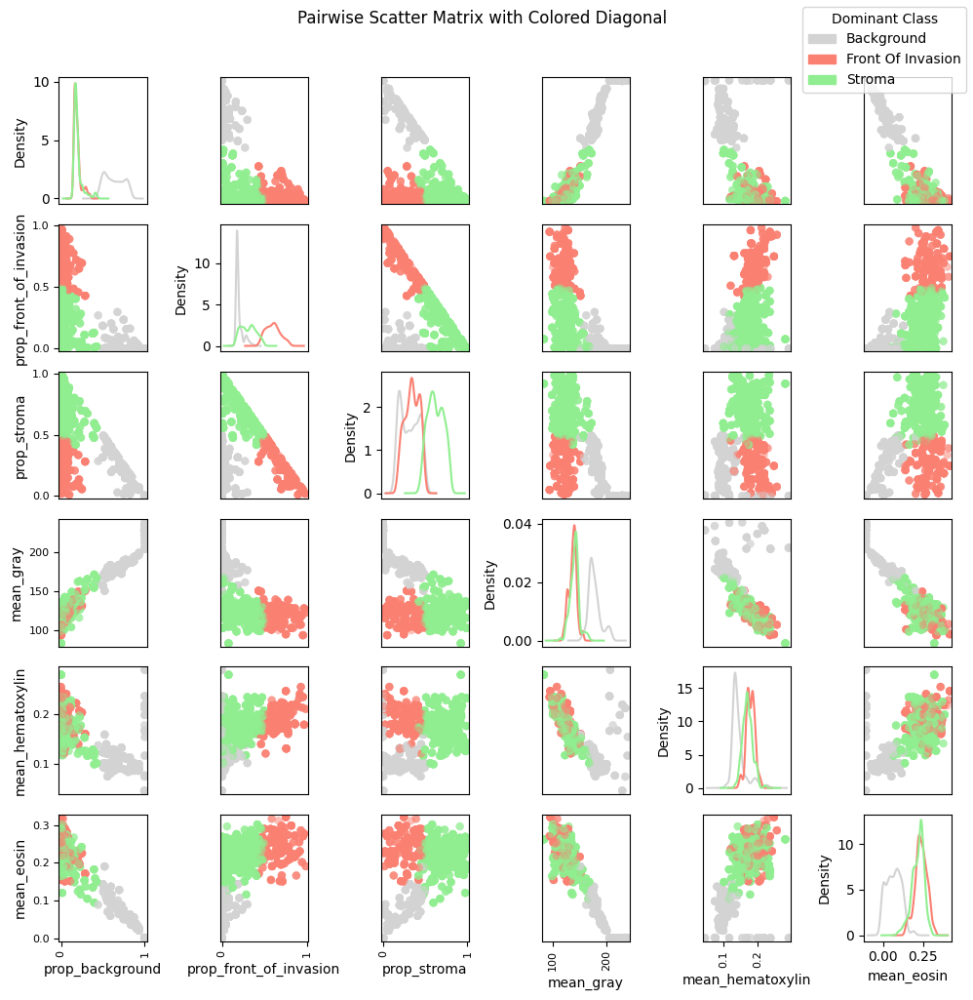

In [23]:
plt.savefig("pairwise_scatter_matrix_colored_diagonal.png", format="png")


<Figure size 640x480 with 0 Axes>